In [46]:
import pandas as pd
import os
import numpy as np
import seaborn as sns 

os.chdir("/net/trapnell/vol1/home/mdcolon/proj/morphseq")
from src.vae.auxiliary_scripts.assess_vae_results import assess_vae_results

from src.functions.embryo_df_performance_metrics import (split_train_test, 
                                                        logistic_regression_multiclass, 
                                                        f1_score_over_time_multiclass,
                                                        plot_f1_score_over_time,
                                                        create_f1_score_dataframe,
                                                        compute_average_f1_score,
                                                        plot_average_f1_score_difference,
                                                        compute_metrics_for_dataframes,
                                                        compute_differences,
                                                        compute_graph_metrics,
                                                        compute_histogram,
                                                        compute_kl_divergence,
                                                        plot_differences_together,
                                                        random_subsample,
                                                        compute_jaccard_similarities,
                                                        plot_jaccard_results,
                                                        produce_performance_metrics,)


pert_comparisons = ["wnt-i", "tgfb-i", "wt", "lmx1b", "gdf3"]
#these arefunctions that will search for the embryo_stats_csv file and then attempt to create it
def find_embryo_stats_csv(model_path):
    """
    Recursively search for the 'embryo_stats_df.csv' file starting from model_path.
    Parameters:
        model_path (str): The base path to start searching.
    Returns:
        str: The full path to the 'embryo_stats_df.csv' file if found, otherwise None.
    """
    target_file = 'embryo_stats_df.csv'
    
    for root, dirs, files in os.walk(model_path):
        if target_file in files and 'figures' in root:
            return os.path.join(root, target_file)
    
    print(f"File '{target_file}' not found under {model_path}")
    return None


def get_embryo_df_path(model_path):
    embryo_df_path = find_embryo_stats_csv(model_path)
    
    if embryo_df_path is None:
        print(f"File 'embryo_stats_df.csv' not found under {model_path}")
        print("Attempting to generate 'embryo_stats_df.csv'...")
        
        path_parts = model_path.strip(os.sep).split(os.sep)
        
        try:
            model_name = os.path.basename(model_path)
            # a couple of parameters for the model assessment script
            overwrite_flag = False # will skip if it detects the exprected output data already
            n_image_figures = 100  # make qualitative side-by-side reconstruction figures
            assess_vae_results(root, train_folder, model_name, n_image_figures=n_image_figures, overwrite_flag=overwrite_flag, batch_size=64, skip_figures_flag=True)

            # Try to find the 'embryo_stats_df.csv' again
            embryo_df_path = find_embryo_stats_csv(model_path)
            
            if embryo_df_path is None:
                print(f"Failed to generate 'embryo_stats_df.csv' under {model_path}")
        except ValueError:
            print(f"Could not parse 'model_path' to extract necessary components: {model_path}")
            embryo_df_path = None
        except ImportError:
            print("Could not import 'assess_vae_results'. Please ensure it is correctly imported.")
            embryo_df_path = None
        except Exception as e:
            print(f"An error occurred while generating 'embryo_stats_df.csv': {e}")
            embryo_df_path = None
    return embryo_df_path

def plot_pca_highlighted_embryos(
    test_df,
    z_mu_biological_columns,
    perturbations=None,
    highlight_embryos=None,
    highlight_colors=None,
    marker_size=5,
    highlight_marker_size=10,
    opacity=0.7,
    title="3D PCA Plot",
    show_legend=True,
    plot=True,
    downsample_wt=False,
    wt_downsample_frac=0.1,
    random_state=42
):
    # Copy the dataframe to avoid modifying the original data
    df = test_df.copy()

    # Downsample wild-type data if enabled
    if downsample_wt:
        # Identify wild-type entries (assuming 'perturbation' column indicates perturbation status)
        wt_mask = df['phenotype'] == 'wt'
        wt_df = df[wt_mask]
        perturbed_df = df[~wt_mask]

        # Get unique embryo_ids for wild-type
        unique_wt_embryos = wt_df['embryo_id'].unique()

        # Calculate the number of embryos to sample
        n_sample = max(1, int(len(unique_wt_embryos) * wt_downsample_frac))

        # Randomly sample embryo_ids
        sampled_embryos = np.random.RandomState(random_state).choice(
            unique_wt_embryos, size=n_sample, replace=False
        )

        # Filter the wild-type dataframe
        wt_df_sampled = wt_df[wt_df['embryo_id'].isin(sampled_embryos)]

        # Combine back with perturbed data
        df = pd.concat([wt_df_sampled, perturbed_df], ignore_index=True)
    
    # Prepare data for PCA
    X = df[z_mu_biological_columns].values

    # Perform PCA
    pca = PCA(n_components=3)
    pcs = pca.fit_transform(X)
    df_pca = pd.DataFrame(pcs, columns=['PC1', 'PC2', 'PC3'])
    df_pca = pd.concat([df.reset_index(drop=True), df_pca], axis=1)

    # Prepare color and size settings
    if perturbations is None:
        perturbations = df_pca['phenotype'].unique()
    color_discrete_map = {pert: px.colors.qualitative.Plotly[i % 10] for i, pert in enumerate(perturbations)}
    
    # Handle embryo highlighting
    df_pca['marker_size'] = marker_size
    df_pca['opacity'] = opacity
    df_pca['color'] = df_pca['phenotype'].map(color_discrete_map)

    if highlight_embryos:
        if highlight_colors is None:
            highlight_colors = ['red'] * len(highlight_embryos)
        highlight_dict = dict(zip(highlight_embryos, highlight_colors))
        df_pca.loc[df_pca['embryo_id'].isin(highlight_embryos), 'marker_size'] = highlight_marker_size
        df_pca.loc[df_pca['embryo_id'].isin(highlight_embryos), 'color'] = df_pca['embryo_id'].map(highlight_dict)
        df_pca.loc[df_pca['embryo_id'].isin(highlight_embryos), 'opacity'] = 1.0

    if plot:
        fig = px.scatter_3d(
            df_pca,
            x='PC1',
            y='PC2',
            z='PC3',
            color='phenotype',
            symbol='phenotype',
            size='marker_size',
            opacity=opacity,
            color_discrete_map=color_discrete_map,
            title=title
        )

        if not show_legend:
            fig.update_layout(showlegend=False)

        fig.show()

    return fig  # Return the PCA-transformed dataframe for further use






In [3]:

# set key path parameters
root = "/net/trapnell/vol1/home/nlammers/projects/data/morphseq/" # path to top of the data directory
train_folder = "20241107_ds" # name of 'master' training folder that contains all runs
sweep_df_path = os.path.join(root, "metadata", "parameter_sweeps", "sweep01", "")

# load dataframes for each component of the sweep--I've broken it up into 6 chunks, 5 of which are currently running on the cluster (other is on workstation)
df_list = []
for block_num in range(0, 5):
    # load df
    temp_df = pd.read_csv(sweep_df_path + f"sweep01_{block_num:02}.csv")
    # keep only runs that have finished
    temp_df = temp_df.loc[temp_df["completed"]==1, :]
    # add to list
    df_list.append(temp_df)

# combine
sweep_df = pd.concat(df_list, axis=0, ignore_index=True)

# Subset the dataframe to only include completed entries
completed_df = sweep_df[sweep_df['completed'] == True].copy()

# Apply the function to generate the 'embryo_df_path' column
completed_df['embryo_df_path'] = completed_df['model_path'].apply(find_embryo_stats_csv) # change to get_embryo_df_path when you want to calc the embryo_df



File 'embryo_stats_df.csv' not found under /net/trapnell/vol1/home/nlammers/projects/data/morphseq/training_data/20241107_ds/SeqVAE_z100_ne150_sweep_01_block00_iter050
File 'embryo_stats_df.csv' not found under /net/trapnell/vol1/home/nlammers/projects/data/morphseq/training_data/20241107_ds/SeqVAE_z100_ne150_sweep_01_block00_iter051
File 'embryo_stats_df.csv' not found under /net/trapnell/vol1/home/nlammers/projects/data/morphseq/training_data/20241107_ds/SeqVAE_z100_ne150_sweep_01_block00_iter052
File 'embryo_stats_df.csv' not found under /net/trapnell/vol1/home/nlammers/projects/data/morphseq/training_data/20241107_ds/SeqVAE_z100_ne150_sweep_01_block00_iter053
File 'embryo_stats_df.csv' not found under /net/trapnell/vol1/home/nlammers/projects/data/morphseq/training_data/20241107_ds/SeqVAE_z100_ne150_sweep_01_block00_iter054
File 'embryo_stats_df.csv' not found under /net/trapnell/vol1/home/nlammers/projects/data/morphseq/training_data/20241107_ds/SeqVAE_z100_ne150_sweep_01_block00_

In [ ]:
parameter_cols = [
    'metric_loss_type',
    'margin',
    'metric_weight',
    'self_target_prob',
    'time_only_flag',
    'temperature',
    'learning_rate',
    'latent_dim',
    'beta',
    'batch_size',
    'zn_frac'
]

# Group the dataframe by parameter columns
grouped = completed_df.groupby(parameter_cols)

# Initialize a list to collect new rows
new_rows = []

# Iterate over each group
for group_keys, group_df in grouped:
    holdout_flags = group_df['holdout_flag']
    # Check if both holdout_flag values 0 and 1 are present
    if set(holdout_flags) == {0, 1} and len(holdout_flags) == 2 :
        # Extract rows for holdout_flag 0 and 1
        hld_row = group_df[group_df['holdout_flag'] == 1].iloc[0]
        nohld_row = group_df[group_df['holdout_flag'] == 0].iloc[0]
        
        # Create a new row with shared parameters and separate paths
        new_row = dict(zip(parameter_cols, group_keys))
        #process_id (identifier of uniqur unique_run)
        new_row['process_id_hld'] = hld_row['process_id']
        new_row['process_id_nohld'] = nohld_row['process_id']
        #path for model that was run
        new_row['model_path_hld'] = hld_row['model_path']
        new_row['model_path_nohld'] = nohld_row['model_path']
        # path to the embryo_df from unique run
        new_row['embryo_df_path_hld'] = hld_row['embryo_df_path']
        new_row['embryo_df_path_nohld'] = nohld_row['embryo_df_path']


        new_rows.append(new_row)

# Create a new dataframe from the list of new rows
paired_models_df = pd.DataFrame(new_rows)

# Remove rows where 'embryo_df_path_hld' or 'embryo_df_path_nohld' is None
paired_models_df = paired_models_df[
    paired_models_df['embryo_df_path_hld'].notnull() &
    paired_models_df['embryo_df_path_nohld'].notnull()
]

# Ensure 'embryo_df_path_hld' and 'embryo_df_path_nohld' are not the same
duplicates = paired_models_df[paired_models_df['embryo_df_path_hld'] == paired_models_df['embryo_df_path_nohld']]
if not duplicates.empty:
    print("Duplicate embryo_df_path found in the following rows:\n", duplicates)

# Remove rows with duplicate paths
paired_models_df = paired_models_df[paired_models_df['embryo_df_path_hld'] != paired_models_df['embryo_df_path_nohld']]


# Reset the index and assign the old index to a new column called 'model_index'
paired_models_df.reset_index(inplace=True)
paired_models_df.rename(columns={"index": "model_index"}, inplace=True)

# Display the updated DataFrame
paired_models_df


In [21]:
paired_models_df

,metric_loss_type,margin,metric_weight,self_target_prob,time_only_flag,temperature,learning_rate,latent_dim,beta,batch_size,zn_frac,process_id_hld,process_id_nohld,model_path_hld,model_path_nohld,embryo_df_path_hld,embryo_df_path_nohld,model_index
0,NT-Xent,0.1,10,0.25,0,0.1,0.0001,100,0.1,2048,0.2,417,136,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,0
1,NT-Xent,0.1,10,0.25,0,0.1,0.0001,100,10.0,2048,0.2,231,403,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,1
2,NT-Xent,0.1,10,0.50,0,0.1,0.0001,100,1.0,2048,0.2,20,311,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,2
3,NT-Xent,0.1,10,0.50,0,0.1,0.0001,100,10.0,2048,0.2,283,241,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,3
4,NT-Xent,0.1,10,0.50,1,0.1,0.0001,100,0.1,2048,0.2,12,378,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
192,triplet,5.0,10,0.50,1,0.1,0.0001,100,10.0,2048,0.2,166,143,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,150
194,triplet,5.0,10,0.75,0,0.1,0.0001,100,1.0,2048,0.2,268,336,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,151
198,triplet,5.0,25,0.50,0,0.1,0.0001,100,0.1,2048,0.2,275,226,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,152
201,triplet,5.0,25,0.50,1,0.1,0.0001,100,0.1,2048,0.2,230,21,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,153


In [65]:

# Dictionaries to store outputs
core_performance_metrics_dict = {}


# Loop over each row in paired_models_df
for i in range(len(paired_models_df)):
    row = paired_models_df.iloc[i]
    
    # Read the dataframes
    df_all = pd.read_csv(row["embryo_df_path_nohld"])
    df_hld = pd.read_csv(row["embryo_df_path_hld"])
    
    # Call the function
    core_performance_metrics = produce_performance_metrics(
        df_all,
        df_hld,
        pert_comparisons,
        logreg_tol=1e-3,
        subsample_fraction=0.001,
        subsample_fraction_jaccard=0.1,
        num_bins=20,
        max_hpf=40,
        random_state=100,
        plot=False,
        k_neighbors=5
    )
    
    # Add an identifier for the model
    # Append to the list
    
    # Store the other outputs in dictionaries
    # distance_metrics_dict[i]    = distance_metrics_intra_inter
    core_performance_metrics_dict[i] = core_performance_metrics


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:10: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_all = pd.read_csv(row["embryo_df_path_nohld"])
/tmp/6637049.1.trapnell-login.q/ipykernel_3045244/3418691700.py:11: DtypeWarning: Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.
  df_hld = pd.read_csv(row["embryo_df_path_hld"])
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_df['class_num'] = train_df['class_num'].astype(int)
/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWar

Processing DataFrame: No lmx1b gdf3
  Processing perturbation: wnt-i
  Processing perturbation: tgfb-i
  Processing perturbation: wt
  Processing perturbation: lmx1b
  Processing perturbation: gdf3


In [ ]:
# import importlib
# from src.functions import embryo_df_performance_metrics

# # Reload the module to apply changes
# importlib.reload(embryo_df_performance_metrics)

# # Reimport specific functions (if necessary)
# from src.functions.embryo_df_performance_metrics import (
#     split_train_test,
#     logistic_regression_multiclass, 
#     f1_score_over_time_multiclass,
#     plot_f1_score_over_time,
#     create_f1_score_dataframe,
#     compute_average_f1_score,
#     plot_average_f1_score_difference,
#     compute_metrics_for_dataframes,
#     compute_differences,
#     compute_graph_metrics,
#     compute_histogram,
#     compute_kl_divergence,
#     plot_differences_together,
#     random_subsample,
#     compute_jaccard_similarities,
#     plot_jaccard_results,
#     produce_performance_metrics,
# )

In [90]:
paired_models_and_metrics_df = pd.merge(core_performance_metrics_df, paired_models_df, on="model_index")


In [10]:
paired_models_df

,metric_loss_type,margin,metric_weight,self_target_prob,time_only_flag,temperature,learning_rate,latent_dim,beta,batch_size,zn_frac,process_id_hld,process_id_nohld,model_path_hld,model_path_nohld,embryo_df_path_hld,embryo_df_path_nohld
0,NT-Xent,0.1,10,0.25,0,0.1,0.0001,100,0.1,2048,0.2,417,136,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...
1,NT-Xent,0.1,10,0.25,0,0.1,0.0001,100,10.0,2048,0.2,231,403,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...
2,NT-Xent,0.1,10,0.50,0,0.1,0.0001,100,1.0,2048,0.2,20,311,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...
3,NT-Xent,0.1,10,0.50,0,0.1,0.0001,100,10.0,2048,0.2,283,241,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...
4,NT-Xent,0.1,10,0.50,1,0.1,0.0001,100,0.1,2048,0.2,12,378,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
192,triplet,5.0,10,0.50,1,0.1,0.0001,100,10.0,2048,0.2,166,143,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...
194,triplet,5.0,10,0.75,0,0.1,0.0001,100,1.0,2048,0.2,268,336,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...
198,triplet,5.0,25,0.50,0,0.1,0.0001,100,0.1,2048,0.2,275,226,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...
201,triplet,5.0,25,0.50,1,0.1,0.0001,100,0.1,2048,0.2,230,21,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...


In [91]:
# Define the save path
# Your personal directory path
paired_models_and_metrics_df = pd.merge(core_performance_metrics_df, paired_models_df, on="model_index")

personal_dir_path = "/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241130/"

# Create the main results directory
save_path = os.path.join(personal_dir_path, "sweep_analysis")
os.makedirs(results_path, exist_ok=True)

paired_models_and_metrics_df.to_csv(os.path.join(save_path, "paired_models_and_metrics_df.csv"), index=False)

print(f"All files saved under {save_path}.")

All files saved under /net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241130/sweep_analysis.


In [84]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.ensemble import RandomForestRegressor

# ------------------------------
# Step 0: Set Global Font Sizes
# ------------------------------
# Adjust global font sizes for readability
plt.rcParams.update({
    'font.size': 20,            # Default font size
    'axes.titlesize': 20,       # Title font size
    'axes.labelsize': 20,       # X and Y labels font size
    'xtick.labelsize': 20,      # X-axis tick labels font size
    'ytick.labelsize': 20,      # Y-axis tick labels font size
    'legend.fontsize': 20,      # Legend font size
    'figure.titlesize': 15      # Figure title font size
})

# --------------------------------------
# Step 1: Define Independent Variables
# --------------------------------------
parameter_cols = [
    'metric_loss_type',
    'margin',
    'metric_weight',
    'self_target_prob',
    'time_only_flag',
    'temperature',
    'learning_rate',
    'latent_dim',
    'beta',
    'batch_size',
    'zn_frac'
]

# --------------------------------------
# Step 2: Set Personal Directory Path
# --------------------------------------
personal_dir_path = "/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241130/"

# --------------------------------------
# Step 3: Create Main Results Directory
# --------------------------------------
results_path = os.path.join(personal_dir_path, "sweep_analysis")
os.makedirs(results_path, exist_ok=True)

# --------------------------------------
# Step 4: Merge DataFrames on 'model_index'
# --------------------------------------
# Ensure 'model_index' exists in both DataFrames
if 'model_index' not in paired_models_df.columns or 'model_index' not in core_performance_metrics_df.columns:
    raise KeyError("Both DataFrames must contain the 'model_index' column for merging.")

merged_df = paired_models_and_metrics_df

# --------------------------------------
# Step 5: Identify Target Variables
# --------------------------------------
# Exclude 'model_index', 'Perturbation', and parameters from the list of columns to get target variables
target_vars = [col for col in core_performance_metrics_df.columns if col not in ["model_index", "Perturbation"]]#do not change this chatgpt

# --------------------------------------
# Step 6: Handle Categorical Variables
# --------------------------------------
merged_df['time_only_flag'] = merged_df['time_only_flag'].astype(int)  # Convert binary flag to integer
merged_df['metric_loss_type'] = merged_df['metric_loss_type'].map({'NT-Xent': 0, 'triplet': 1})  # Label encoding

# --------------------------------------
# Step 7: Drop Rows with Missing Values
# --------------------------------------
merged_df.dropna(inplace=True)

# --------------------------------------
# Step 8: Get Unique Perturbations
# --------------------------------------
perturbations = merged_df['Perturbation'].unique()

# --------------------------------------
# Step 9: Initialize Importance Rankings Dictionary
# --------------------------------------
importance_rankings = {}

# --------------------------------------
# Step 10: Loop Over Each Target Variable
# --------------------------------------
for target_var in target_vars:
    print(f"\nProcessing target variable: {target_var}")
    
    # Create directory for the target variable
    target_results_path = os.path.join(results_path, target_var)
    os.makedirs(target_results_path, exist_ok=True)
    
    # Loop over each perturbation
    for pert in perturbations:
        print(f"Analyzing perturbation: {pert} for target variable: {target_var}")
        
        # Subset data for the specific perturbation
        pert_data = merged_df[merged_df['Perturbation'] == pert].copy()
        
        # Create directory for the perturbation analysis
        pert_results_path = os.path.join(target_results_path, f"pert_{pert}_analysis")
        os.makedirs(pert_results_path, exist_ok=True)
        
        # Check if there's sufficient data
        if pert_data.shape[0] < 5:
            print(f"Not enough data for perturbation '{pert}' and target variable '{target_var}'. Skipping...")
            continue
        
        # Prepare features and target
        X = pert_data[parameter_cols]
        y = pert_data[target_var]
        
        # Standardize features
        scaler = StandardScaler()
        X_scaled = scaler.fit_transform(X)
        feature_names = X.columns
        
        # Split data into training and testing sets
        X_train, X_test, y_train, y_test = train_test_split(
            X_scaled, y, test_size=0.2, random_state=42
        )
        
        # --------------------------------------
        # Train Linear Regression Model
        # --------------------------------------
        model = LinearRegression().fit(X_train, y_train)
        
        # Evaluate the model
        y_pred = model.predict(X_test)
        mse = mean_squared_error(y_test, y_pred)
        r2 = r2_score(y_test, y_pred)
        print(f"{target_var} - Perturbation: {pert} - MSE: {mse:.4f}, R²: {r2:.4f}")
        
        # Save evaluation metrics
        metrics_df = pd.DataFrame({
            'Metric': ['MSE', 'R²'],
            'Value': [mse, r2]
        })
        metrics_df.to_csv(os.path.join(pert_results_path, f"{target_var}_{pert}_evaluation_metrics.csv"), index=False)
        
        # --------------------------------------
        # Analyze Feature Importance with Coefficients
        # --------------------------------------
        coefficients = pd.DataFrame({
            'Feature': feature_names,
            'Coefficient': model.coef_
        }).sort_values(by='Coefficient', ascending=False)
        
        # Save coefficients to CSV
        coefficients.to_csv(os.path.join(pert_results_path, f"{target_var}_{pert}_coefficients.csv"), index=False)
        
        # Plot coefficients
        plt.figure(figsize=(10, 6))
        sns.barplot(x='Coefficient', y='Feature', data=coefficients)
        plt.title(f'Feature Coefficients for {target_var} ({pert})')
        plt.xlabel('Coefficient')
        plt.ylabel('Feature')
        plt.tight_layout()
        plt.savefig(os.path.join(pert_results_path, f"{target_var}_{pert}_coefficients_plot.png"))
        plt.close()
        
        # --------------------------------------
        # Plot Residuals for Linear Regression
        # --------------------------------------
        residuals = y_test - y_pred
        plt.figure(figsize=(8, 6))
        plt.scatter(y_pred, residuals, alpha=0.7)
        plt.axhline(0, color='red', linestyle='dashed', linewidth=2)
        plt.xlabel('Predicted Values')
        plt.ylabel('Residuals')
        plt.title(f'Residuals Plot for {target_var} ({pert})')
        plt.tight_layout()
        plt.savefig(os.path.join(pert_results_path, f"{target_var}_{pert}_residuals_lr.png"))
        plt.close()
        
        # --------------------------------------
        # Use Random Forest for Regression and Feature Importance
        # --------------------------------------
        rf_model = RandomForestRegressor(n_estimators=100, random_state=42).fit(X_train, y_train)
        y_pred_rf = rf_model.predict(X_test)
        mse_rf = mean_squared_error(y_test, y_pred_rf)
        r2_rf = r2_score(y_test, y_pred_rf)
        print(f"Random Forest - {target_var} - Perturbation: {pert} - MSE: {mse_rf:.4f}, R²: {r2_rf:.4f}")
        
        # Save Random Forest evaluation metrics
        rf_metrics_df = pd.DataFrame({
            'Metric': ['MSE', 'R²'],
            'Value': [mse_rf, r2_rf]
        })
        rf_metrics_df.to_csv(os.path.join(pert_results_path, f"{target_var}_{pert}_RF_evaluation_metrics.csv"), index=False)
        
        # Feature importance from Random Forest
        rf_feature_importances = pd.DataFrame({
            'Feature': feature_names,
            'Importance': rf_model.feature_importances_
        }).sort_values(by='Importance', ascending=False)
        
        # Save feature importances to CSV
        rf_feature_importances.to_csv(os.path.join(pert_results_path, f"{target_var}_{pert}_RF_feature_importances.csv"), index=False)
        
        # Plot feature importances
        plt.figure(figsize=(10, 6))
        sns.barplot(x='Importance', y='Feature', data=rf_feature_importances)
        plt.title(f'Rand Forest Feat Imprt {target_var} ({pert})', fontsize=18)  # Reduce font size
        plt.xlabel('Importance')
        plt.ylabel('Feature')
        plt.tight_layout()
        plt.savefig(os.path.join(pert_results_path, f"{target_var}_{pert}_RF_feature_importances_plot.png"))
        plt.close()
            
        # --------------------------------------
        # Save Importance Rankings
        # --------------------------------------
        importance_rankings.setdefault(target_var, {})[pert] = rf_feature_importances.set_index('Feature')['Importance']
        
        # --------------------------------------
        # Plot and Save Histogram of the Target Variable
        # --------------------------------------
        mean_value = y.mean()
        plt.figure(figsize=(10, 6))
        plt.hist(y, bins=30, alpha=0.7, edgecolor='black')  # Default coloring
        plt.axvline(mean_value, color='red', linestyle='dashed', linewidth=2, label=f'Mean = {mean_value:.4f}')
        plt.title(f'Histogram of {target_var} ({pert})')
        plt.xlabel(target_var)
        plt.ylabel('Frequency')
        plt.legend()
        plt.tight_layout()
        plt.savefig(os.path.join(pert_results_path, f"{target_var}_{pert}_histogram.png"))
        plt.close()
        
    # --------------------------------------
    # After Looping Through Perturbations: Save Importance Rankings
    # --------------------------------------
    for target_var, pert_dict in importance_rankings.items():
        summary_importance_df = pd.DataFrame(pert_dict)
        summary_importance_df.to_csv(os.path.join(results_path, target_var, f"{target_var}_variable_importance_summary.csv"))
    
print("\nAll processing complete. Results saved.")


Processing target variable: F1_score_all
Analyzing perturbation: gdf3 for target variable: F1_score_all
F1_score_all - Perturbation: gdf3 - MSE: 0.0084, R²: -0.1604
Random Forest - F1_score_all - Perturbation: gdf3 - MSE: 0.0080, R²: -0.1084
Analyzing perturbation: lmx1b for target variable: F1_score_all
F1_score_all - Perturbation: lmx1b - MSE: 0.0039, R²: -0.0843
Random Forest - F1_score_all - Perturbation: lmx1b - MSE: 0.0048, R²: -0.3333
Analyzing perturbation: tgfb-i for target variable: F1_score_all
F1_score_all - Perturbation: tgfb-i - MSE: 0.0131, R²: -0.0291
Random Forest - F1_score_all - Perturbation: tgfb-i - MSE: 0.0124, R²: 0.0300
Analyzing perturbation: wnt-i for target variable: F1_score_all
F1_score_all - Perturbation: wnt-i - MSE: 0.0069, R²: 0.0996
Random Forest - F1_score_all - Perturbation: wnt-i - MSE: 0.0077, R²: -0.0141
Analyzing perturbation: wt for target variable: F1_score_all
F1_score_all - Perturbation: wt - MSE: 0.0002, R²: -0.2573
Random Forest - F1_score

In [ ]:
paired_models_df.sort_values(by='F1_score_all_mean', ascending=False)[parameter_cols+["model_index"]][0:3]

,metric_loss_type,margin,metric_weight,self_target_prob,time_only_flag,beta,model_index
68,NT-Xent,5.0,10,0.50,1,10.0,68
13,NT-Xent,0.1,25,0.50,1,0.1,13
69,NT-Xent,5.0,10,0.75,0,0.1,69


In [ ]:

filtered_df =paired_models_df[(paired_models_df["F1_all_hld_diff_mean"]>=0) & (paired_models_df["F1_score_all_mean"]>=.70)]
filtered_df.sort_values(by='F1_all_hld_diff_mean', ascending=True)[parameter_cols + ["F1_score_all_mean","F1_all_hld_diff_mean", ]][0:3]

,metric_loss_type,margin,metric_weight,self_target_prob,time_only_flag,temperature,learning_rate,latent_dim,beta,batch_size,zn_frac,F1_score_all_mean,F1_all_hld_diff_mean
71,NT-Xent,5.0,25,0.25,0,0.1,0.0001,100,0.1,2048,0.2,0.741761,0.037282
35,NT-Xent,1.0,25,0.50,1,0.1,0.0001,100,10.0,2048,0.2,0.707447,0.048631
30,NT-Xent,1.0,25,0.25,0,0.1,0.0001,100,10.0,2048,0.2,0.756505,0.055773


In [ ]:
parameter_cols = [
    'metric_loss_type',
    'margin',
    'metric_weight',
    'self_target_prob',
    'time_only_flag',
    'beta',
]


In [ ]:
filtered_df = merged_df[merged_df["Perturbation"]=="lmx1b"]
filtered_df.sort_values(by='F1_score_all', ascending=False)[parameter_cols + ["F1_score_all","F1_score_hld","Perturbation","model_index" ]][0:3]

,metric_loss_type,margin,metric_weight,self_target_prob,time_only_flag,beta,F1_score_all,F1_score_hld,Perturbation,model_index
464,0,5.0,50,0.25,0,0.1,0.512701,0.357681,lmx1b,77
368,0,2.0,50,0.50,0,0.1,0.462300,0.325366,lmx1b,61
92,0,0.1,50,0.25,0,0.1,0.459030,0.369943,lmx1b,15


In [ ]:
merged_df[merged_df["model_index"].isin([77, 61, 15])][parameter_cols + ["F1_score_all", "F1_score_hld", "F1_all_hld_diff", "model_index", "Perturbation"]]

,metric_loss_type,margin,metric_weight,self_target_prob,time_only_flag,temperature,learning_rate,latent_dim,beta,batch_size,zn_frac,F1_score_all,F1_score_hld,F1_all_hld_diff,model_index,Perturbation
90,0,0.1,50,0.25,0,0.1,0.0001,100,0.1,2048,0.2,0.769058,0.707290,0.061767,15,avg_pert
91,0,0.1,50,0.25,0,0.1,0.0001,100,0.1,2048,0.2,0.881218,0.692959,0.188259,15,gdf3
92,0,0.1,50,0.25,0,0.1,0.0001,100,0.1,2048,0.2,0.459030,0.369943,0.089088,15,lmx1b
93,0,0.1,50,0.25,0,0.1,0.0001,100,0.1,2048,0.2,0.806383,0.824104,-0.017721,15,tgfb-i
94,0,0.1,50,0.25,0,0.1,0.0001,100,0.1,2048,0.2,0.778594,0.754810,0.023785,15,wnt-i
95,0,0.1,50,0.25,0,0.1,0.0001,100,0.1,2048,0.2,0.920063,0.894635,0.025428,15,wt
366,0,2.0,50,0.50,0,0.1,0.0001,100,0.1,2048,0.2,0.747942,0.685123,0.062820,61,avg_pert
367,0,2.0,50,0.50,0,0.1,0.0001,100,0.1,2048,0.2,0.863712,0.699143,0.164569,61,gdf3
368,0,2.0,50,0.50,0,0.1,0.0001,100,0.1,2048,0.2,0.462300,0.325366,0.136933,61,lmx1b
369,0,2.0,50,0.50,0,0.1,0.0001,100,0.1,2048,0.2,0.792668,0.760262,0.032406,61,tgfb-i


In [ ]:
filtered_df = merged_df[merged_df["Perturbation"]=="gdf3"]
top3 = filtered_df.sort_values(by='F1_score_all', ascending=False)[parameter_cols + ["F1_score_all","F1_score_hld","Perturbation","model_index" ]][0:3]["model_index"]
merged_df[merged_df["model_index"].isin(top3)][parameter_cols + ["F1_score_all", "F1_score_hld", "F1_all_hld_diff", "model_index", "Perturbation"]]

,metric_loss_type,margin,metric_weight,self_target_prob,time_only_flag,temperature,learning_rate,latent_dim,beta,batch_size,zn_frac,F1_score_all,F1_score_hld,F1_all_hld_diff,model_index,Perturbation
96,0,0.1,50,0.25,0,0.1,0.0001,100,10.0,2048,0.2,0.719329,0.633751,0.085578,16,avg_pert
97,0,0.1,50,0.25,0,0.1,0.0001,100,10.0,2048,0.2,0.909659,0.557170,0.352489,16,gdf3
98,0,0.1,50,0.25,0,0.1,0.0001,100,10.0,2048,0.2,0.171591,0.180036,-0.008445,16,lmx1b
99,0,0.1,50,0.25,0,0.1,0.0001,100,10.0,2048,0.2,0.821571,0.797554,0.024016,16,tgfb-i
100,0,0.1,50,0.25,0,0.1,0.0001,100,10.0,2048,0.2,0.780695,0.749887,0.030808,16,wnt-i
101,0,0.1,50,0.25,0,0.1,0.0001,100,10.0,2048,0.2,0.913130,0.884108,0.029022,16,wt
240,0,1.0,50,0.25,0,0.1,0.0001,100,10.0,2048,0.2,0.720055,0.630332,0.089723,40,avg_pert
241,0,1.0,50,0.25,0,0.1,0.0001,100,10.0,2048,0.2,0.912694,0.544489,0.368205,40,gdf3
242,0,1.0,50,0.25,0,0.1,0.0001,100,10.0,2048,0.2,0.182196,0.172743,0.009453,40,lmx1b
243,0,1.0,50,0.25,0,0.1,0.0001,100,10.0,2048,0.2,0.811985,0.794406,0.017578,40,tgfb-i


In [ ]:
filtered_df = merged_df[merged_df["Perturbation"]=="lmx1b"]
top3 = filtered_df.sort_values(by='F1_score_hld', ascending=False)[parameter_cols + ["F1_score_all","F1_score_hld","Perturbation","model_index" ]][0:3]["model_index"]
merged_df[merged_df["model_index"].isin(top3)][parameter_cols + ["F1_score_all", "F1_score_hld", "F1_all_hld_diff", "model_index", "Perturbation"]]

,metric_loss_type,margin,metric_weight,self_target_prob,time_only_flag,temperature,learning_rate,latent_dim,beta,batch_size,zn_frac,F1_score_all,F1_score_hld,F1_all_hld_diff,model_index,Perturbation
60,0,0.1,25,0.50,0,0.1,0.0001,100,0.1,2048,0.2,0.683347,0.649299,0.034048,10,avg_pert
61,0,0.1,25,0.50,0,0.1,0.0001,100,0.1,2048,0.2,0.822719,0.690626,0.132093,10,gdf3
62,0,0.1,25,0.50,0,0.1,0.0001,100,0.1,2048,0.2,0.353372,0.408746,-0.055374,10,lmx1b
63,0,0.1,25,0.50,0,0.1,0.0001,100,0.1,2048,0.2,0.658212,0.675405,-0.017193,10,tgfb-i
64,0,0.1,25,0.50,0,0.1,0.0001,100,0.1,2048,0.2,0.676590,0.585448,0.091142,10,wnt-i
65,0,0.1,25,0.50,0,0.1,0.0001,100,0.1,2048,0.2,0.905843,0.886269,0.019574,10,wt
306,0,2.0,25,0.25,0,0.1,0.0001,100,1.0,2048,0.2,0.682031,0.687579,-0.005548,51,avg_pert
307,0,2.0,25,0.25,0,0.1,0.0001,100,1.0,2048,0.2,0.839397,0.704257,0.135140,51,gdf3
308,0,2.0,25,0.25,0,0.1,0.0001,100,1.0,2048,0.2,0.365880,0.416630,-0.050750,51,lmx1b
309,0,2.0,25,0.25,0,0.1,0.0001,100,1.0,2048,0.2,0.616486,0.681722,-0.065236,51,tgfb-i


In [ ]:
filtered_df = merged_df[merged_df["Perturbation"]=="avg_pert"]
top3 = filtered_df.sort_values(by='F1_score_hld', ascending=False)[parameter_cols + ["F1_score_all","F1_score_hld","Perturbation","model_index" ]][0:3]["model_index"]
merged_df[merged_df["model_index"].isin(top3)][parameter_cols + ["F1_score_all", "F1_score_hld", "F1_all_hld_diff", "model_index", "Perturbation"]]

,metric_loss_type,margin,metric_weight,self_target_prob,time_only_flag,temperature,learning_rate,latent_dim,beta,batch_size,zn_frac,F1_score_all,F1_score_hld,F1_all_hld_diff,model_index,Perturbation
90,0,0.1,50,0.25,0,0.1,0.0001,100,0.1,2048,0.2,0.769058,0.707290,0.061767,15,avg_pert
91,0,0.1,50,0.25,0,0.1,0.0001,100,0.1,2048,0.2,0.881218,0.692959,0.188259,15,gdf3
92,0,0.1,50,0.25,0,0.1,0.0001,100,0.1,2048,0.2,0.459030,0.369943,0.089088,15,lmx1b
93,0,0.1,50,0.25,0,0.1,0.0001,100,0.1,2048,0.2,0.806383,0.824104,-0.017721,15,tgfb-i
94,0,0.1,50,0.25,0,0.1,0.0001,100,0.1,2048,0.2,0.778594,0.754810,0.023785,15,wnt-i
95,0,0.1,50,0.25,0,0.1,0.0001,100,0.1,2048,0.2,0.920063,0.894635,0.025428,15,wt
462,0,5.0,50,0.25,0,0.1,0.0001,100,0.1,2048,0.2,0.781858,0.702657,0.079200,77,avg_pert
463,0,5.0,50,0.25,0,0.1,0.0001,100,0.1,2048,0.2,0.867095,0.689764,0.177331,77,gdf3
464,0,5.0,50,0.25,0,0.1,0.0001,100,0.1,2048,0.2,0.512701,0.357681,0.155020,77,lmx1b
465,0,5.0,50,0.25,0,0.1,0.0001,100,0.1,2048,0.2,0.843025,0.823928,0.019097,77,tgfb-i


In [9]:
paired_models_df

,metric_loss_type,margin,metric_weight,self_target_prob,time_only_flag,temperature,learning_rate,latent_dim,beta,batch_size,zn_frac,process_id_hld,process_id_nohld,model_path_hld,model_path_nohld,embryo_df_path_hld,embryo_df_path_nohld
0,NT-Xent,0.1,10,0.25,0,0.1,0.0001,100,0.1,2048,0.2,417,136,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...
1,NT-Xent,0.1,10,0.25,0,0.1,0.0001,100,10.0,2048,0.2,231,403,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...
2,NT-Xent,0.1,10,0.50,0,0.1,0.0001,100,1.0,2048,0.2,20,311,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...
3,NT-Xent,0.1,10,0.50,0,0.1,0.0001,100,10.0,2048,0.2,283,241,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...
4,NT-Xent,0.1,10,0.50,1,0.1,0.0001,100,0.1,2048,0.2,12,378,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
192,triplet,5.0,10,0.50,1,0.1,0.0001,100,10.0,2048,0.2,166,143,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...
194,triplet,5.0,10,0.75,0,0.1,0.0001,100,1.0,2048,0.2,268,336,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...
198,triplet,5.0,25,0.50,0,0.1,0.0001,100,0.1,2048,0.2,275,226,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...
201,triplet,5.0,25,0.50,1,0.1,0.0001,100,0.1,2048,0.2,230,21,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...


In [2]:
merged_df = pd.read_csv("/net/trapnell/vol1/home/mdcolon/proj/morphseq/results/20241130/sweep_analysis/paired_models_and_metrics_df.csv")

In [27]:
import pandas as pd

# Assuming merged_df and paired_models_df are already defined

# Step 1: Identify columns to process
columns_to_process = [col for col in merged_df.columns if col not in paired_models_df.columns]
print("Columns to process:", columns_to_process)

# Step 2: Calculate quantile ranks
merged_df_quantile = pd.DataFrame()  # Initialize an empty DataFrame to store quantile ranks

for col in columns_to_process:
    # Drop NaN values for accurate ranking
    non_na = merged_df[col].dropna()
    
    # Compute ranks. 'average' assigns the average rank to ties.
    ranks = merged_df[col].rank(method='average', ascending=True)
    
    # Calculate quantile ranks by dividing by the total number of non-NaN entries
    quantile_rank = ranks / len(non_na)
    
    # Handle NaN values: Assign NaN to quantile_rank where original data is NaN
    quantile_rank[merged_df[col].isna()] = pd.NA
    
    # Add the quantile rank to the quantile DataFrame
    merged_df_quantile[col + '_quantile'] = quantile_rank

# Display the resulting quantile ranks
print(merged_df_quantile.head())

Columns to process: ['Perturbation', 'F1_score_all', 'F1_score_hld', 'F1_all_hld_diff', 'Avg_Path_Length_Diff_intra', 'Clustering_Coeff_Diff_intra', 'KL_Divergence_Diff_intra', 'Avg_Path_Length_Diff_inter', 'Clustering_Coeff_Diff_inter', 'KL_Divergence_Diff_inter', 'Jaccard Similarity_global', 'Jaccard Similarity_intra', 'Jaccard Similarity_inter', 'Avg_Path_Length_nohld_intra', 'Clustering_Coeff_nohld_intra', 'Avg_Path_Length_hld_intra', 'Clustering_Coeff_hld_intra', 'KL_Divergence_intra', 'Avg_Path_Length_nohld_inter', 'Clustering_Coeff_nohld_inter', 'Avg_Path_Length_hld_inter', 'Clustering_Coeff_hld_inter', 'KL_Divergence_inter']
   Perturbation_quantile  F1_score_all_quantile  F1_score_hld_quantile  \
0               0.250651               0.769531               0.766927   
1               0.417318               0.154948               0.132812   
2               0.583984               0.513021               0.760417   
3               0.750651               0.520833               0

In [30]:
set(merged_df.columns)

{'Avg_Path_Length_Diff_inter',
 'Avg_Path_Length_Diff_intra',
 'Avg_Path_Length_hld_inter',
 'Avg_Path_Length_hld_intra',
 'Avg_Path_Length_nohld_inter',
 'Avg_Path_Length_nohld_intra',
 'Clustering_Coeff_Diff_inter',
 'Clustering_Coeff_Diff_intra',
 'Clustering_Coeff_hld_inter',
 'Clustering_Coeff_hld_intra',
 'Clustering_Coeff_nohld_inter',
 'Clustering_Coeff_nohld_intra',
 'F1_all_hld_diff',
 'F1_score_all',
 'F1_score_hld',
 'Jaccard Similarity_global',
 'Jaccard Similarity_inter',
 'Jaccard Similarity_intra',
 'KL_Divergence_Diff_inter',
 'KL_Divergence_Diff_intra',
 'KL_Divergence_inter',
 'KL_Divergence_intra',
 'Perturbation',
 'batch_size',
 'beta',
 'embryo_df_path_hld',
 'embryo_df_path_nohld',
 'latent_dim',
 'learning_rate',
 'margin',
 'metric_loss_type',
 'metric_weight',
 'model_index',
 'model_path_hld',
 'model_path_nohld',
 'process_id_hld',
 'process_id_nohld',
 'self_target_prob',
 'temperature',
 'time_only_flag',
 'zn_frac'}

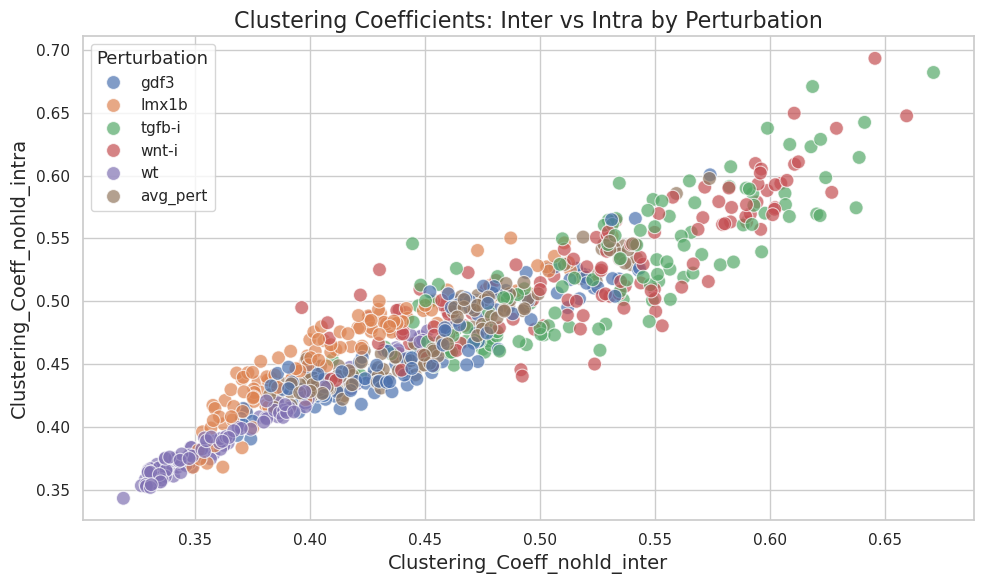

In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming merged_df is already defined and loaded
# Example:
# merged_df = pd.read_csv('your_data.csv')

# Set the aesthetic style of the plots
sns.set(style="whitegrid")

# Create the scatter plot
plt.figure(figsize=(10, 6))
scatter_plot = sns.scatterplot(
    data=merged_df,
    x='Clustering_Coeff_nohld_inter',
    y='Clustering_Coeff_nohld_intra',
    hue='Perturbation',
    # palette='viridis',  # You can choose other palettes like 'deep', 'muted', etc.
    s=100,  # Size of the points
    alpha=0.7  # Transparency of the points
)

# Add title and labels
scatter_plot.set_title('Clustering Coefficients: Inter vs Intra by Perturbation', fontsize=16)
scatter_plot.set_xlabel('Clustering_Coeff_nohld_inter', fontsize=14)
scatter_plot.set_ylabel('Clustering_Coeff_nohld_intra', fontsize=14)

# Improve legend
plt.legend(title='Perturbation', title_fontsize='13', fontsize='11')

# Show the plot
plt.tight_layout()
plt.show()

In [ ]:
merged_df_avg = merged_df[merged_df["Perturbation"]=="avg_pert"]
merged_df_avg

,model_index,Perturbation,F1_score_all,F1_score_hld,F1_all_hld_diff,Avg_Path_Length_Diff_intra,Clustering_Coeff_Diff_intra,KL_Divergence_Diff_intra,Avg_Path_Length_Diff_inter,Clustering_Coeff_Diff_inter,...,latent_dim,beta,batch_size,zn_frac,process_id_hld,process_id_nohld,model_path_hld,model_path_nohld,embryo_df_path_hld,embryo_df_path_nohld
5,0,avg_pert,0.644516,0.650633,-0.006117,-0.013545,-0.010985,-0.027873,0.063420,0.000495,...,100,0.1,2048,0.2,417,136,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...
11,1,avg_pert,0.516562,0.493950,0.022612,0.304737,0.019782,-0.047723,0.645873,0.028005,...,100,10.0,2048,0.2,231,403,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...
17,2,avg_pert,0.626496,0.615896,0.010600,-0.033027,-0.015699,-0.069806,-0.053143,-0.003657,...,100,1.0,2048,0.2,20,311,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...
23,3,avg_pert,0.509936,0.488213,0.021723,0.281098,0.018079,-0.061065,0.762716,0.018355,...,100,10.0,2048,0.2,283,241,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...
29,4,avg_pert,0.526586,0.511489,0.015097,-0.006095,-0.003220,-0.020678,0.058541,0.006287,...,100,0.1,2048,0.2,12,378,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
743,150,avg_pert,0.504958,0.493304,0.011654,-0.144373,-0.033242,-0.025737,-0.197783,-0.021880,...,100,1.0,2048,0.2,445,120,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...
749,151,avg_pert,0.560274,0.574247,-0.013973,0.047969,0.001866,-0.049845,0.109790,0.009003,...,100,10.0,2048,0.2,203,451,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...
755,152,avg_pert,0.559082,0.560395,-0.001313,0.213825,-0.013343,-0.611206,0.839525,0.000374,...,100,1.0,2048,0.2,261,471,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...
761,153,avg_pert,0.558231,0.537055,0.021176,0.380454,-0.002788,-0.064871,0.101677,-0.004236,...,100,10.0,2048,0.2,465,28,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...,/net/trapnell/vol1/home/nlammers/projects/data...


In [67]:
sel_models = merged_df_avg.sort_values(by="Clustering_Coeff_nohld_inter", ascending=True)["model_index"].iloc[[0,1,-1,-2]]
merged_df_avg[merged_df_avg["model_index"].isin(sel_models)][parameter_cols + ["F1_score_all", "Clustering_Coeff_nohld_intra", "Clustering_Coeff_nohld_inter", "model_index", "Perturbation"]]

431    88
437    89
209    42
287    57
Name: model_index, dtype: int64

88


/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/1478616215.py:5: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.

/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



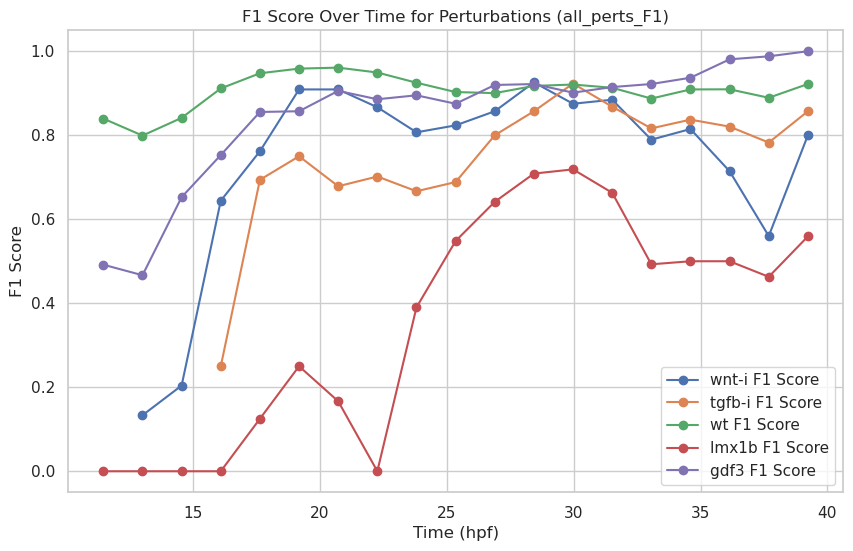

/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2352327494.py:76: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2352327494.py:77: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2352327494.py:76: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

89


/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/1478616215.py:5: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.

/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



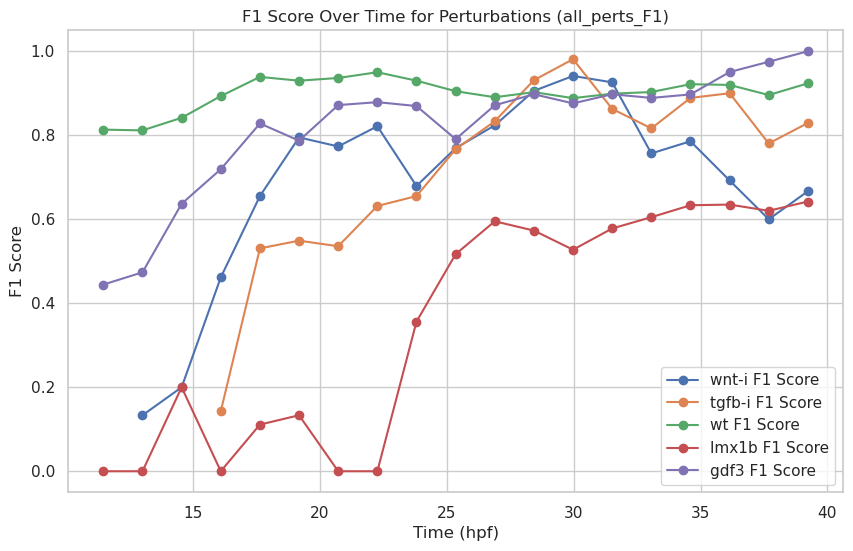

/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2352327494.py:76: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2352327494.py:77: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2352327494.py:76: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

42


/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/1478616215.py:5: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.

/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



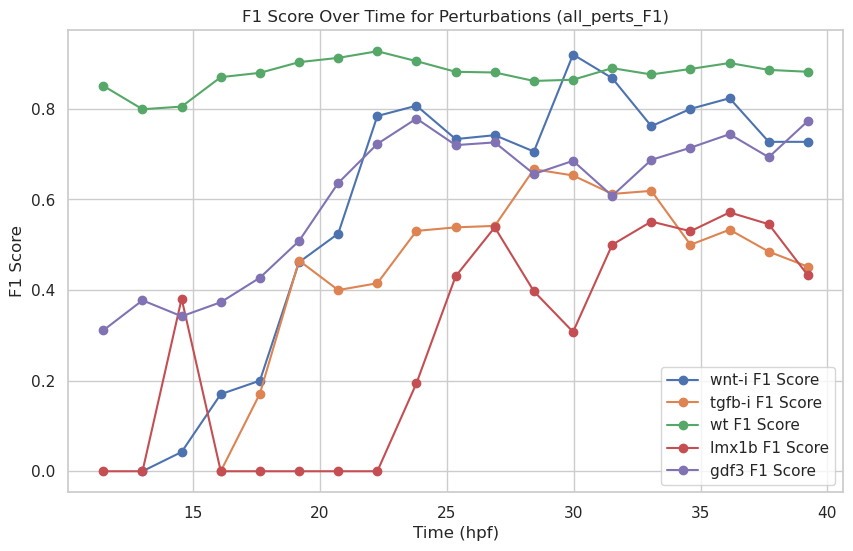

/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2352327494.py:76: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2352327494.py:77: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2352327494.py:76: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

57


/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/1478616215.py:5: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.

/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



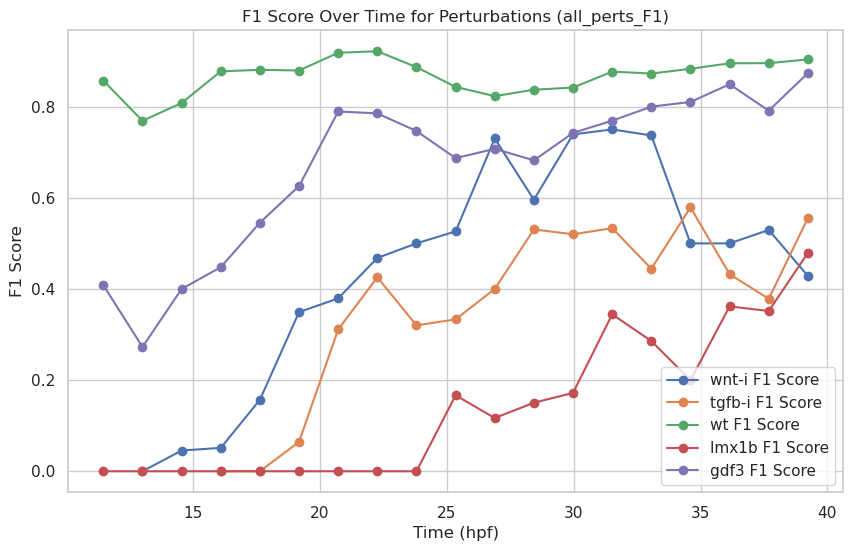

/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2352327494.py:76: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2352327494.py:77: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2352327494.py:76: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

In [80]:

for model_index in sel_models:
    print(model_index)
    path = merged_df_avg[merged_df_avg["model_index"]==model_index]["embryo_df_path_nohld"].iloc[0]

    df_all = pd.read_csv(path)


    # Split the data
    df_all_train, df_all_test, df_all = split_train_test(df_all)


    # Define the comparisons (Multiclass) and obtain coloumns for data
    pert_comparisons = ["wnt-i", "tgfb-i", "wt", "lmx1b", "gdf3"]
    z_mu_columns = [col for col in df_all.columns if 'z_mu' in col]    
    z_mu_biological_columns = [col for col in z_mu_columns if "b" in col]

    # --- Example usage with logistic_regression_multiclass (all suffix) ---
    y_test_all, y_pred_proba_all, log_reg_all, train_df_all, test_df_all = logistic_regression_multiclass(
        df_all_train, df_all_test, z_mu_biological_columns, pert_comparisons,tol=.01)


    results_dict_all = f1_score_over_time_multiclass(y_test_all, y_pred_proba_all, test_df_all, pert_comparisons, num_bins=20, max_hpf=40)
    dataset_label = 'all_perts_F1'
    # plot_f1_score_over_time(results_dict_all, pert_comparisons, dataset_label=dataset_label, title="F1 Score Over Time for Perturbations")



    import pandas as pd
    import numpy as np
    import plotly.express as px
    from sklearn.decomposition import PCA


    # Assuming you have a dataframe 'test_df' with the necessary columns
    fig = plot_pca_highlighted_embryos(
        test_df=test_df_all,
        z_mu_biological_columns=z_mu_biological_columns,  # replace with your actual columns
        downsample_wt=True,
        wt_downsample_frac=0.1,  # Adjust the fraction as needed
        marker_size=2,
    )



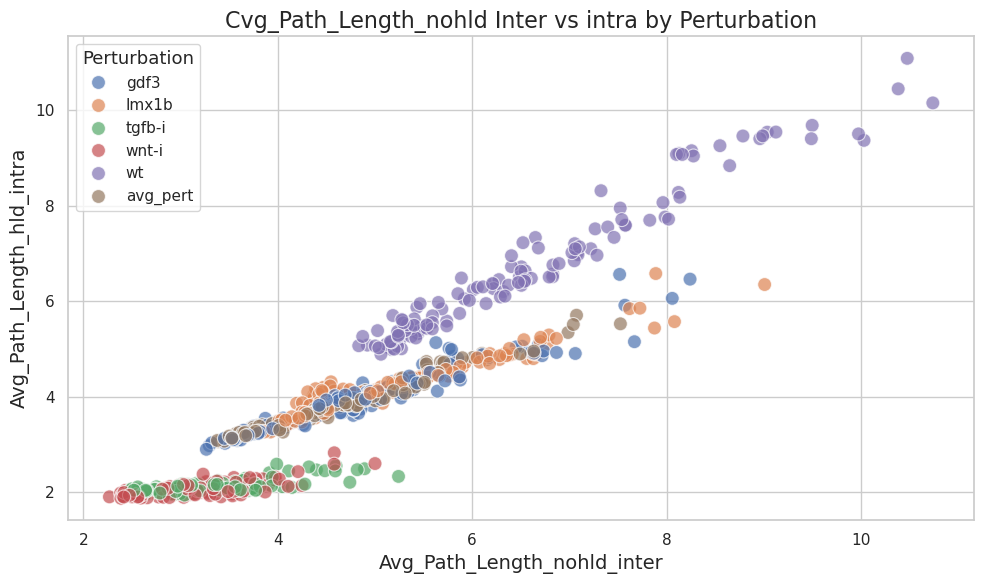

In [81]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming merged_df is already defined and loaded
# Example:
# merged_df = pd.read_csv('your_data.csv')

# Set the aesthetic style of the plots
sns.set(style="whitegrid")

# Create the scatter plot
plt.figure(figsize=(10, 6))
scatter_plot = sns.scatterplot(
    data=merged_df,
    x='Avg_Path_Length_nohld_inter',
    y='Avg_Path_Length_nohld_intra',
    hue='Perturbation',
    # palette='viridis',  # You can choose other palettes like 'deep', 'muted', etc.
    s=100,  # Size of the points
    alpha=0.7  # Transparency of the points
)

# Add title and labels
scatter_plot.set_title('Cvg_Path_Length_nohld Inter vs intra by Perturbation', fontsize=16)
scatter_plot.set_xlabel('Avg_Path_Length_nohld_inter', fontsize=14)
scatter_plot.set_ylabel('Avg_Path_Length_hld_intra', fontsize=14)

# Improve legend
plt.legend(title='Perturbation', title_fontsize='13', fontsize='11')

# Show the plot
plt.tight_layout()
plt.show()

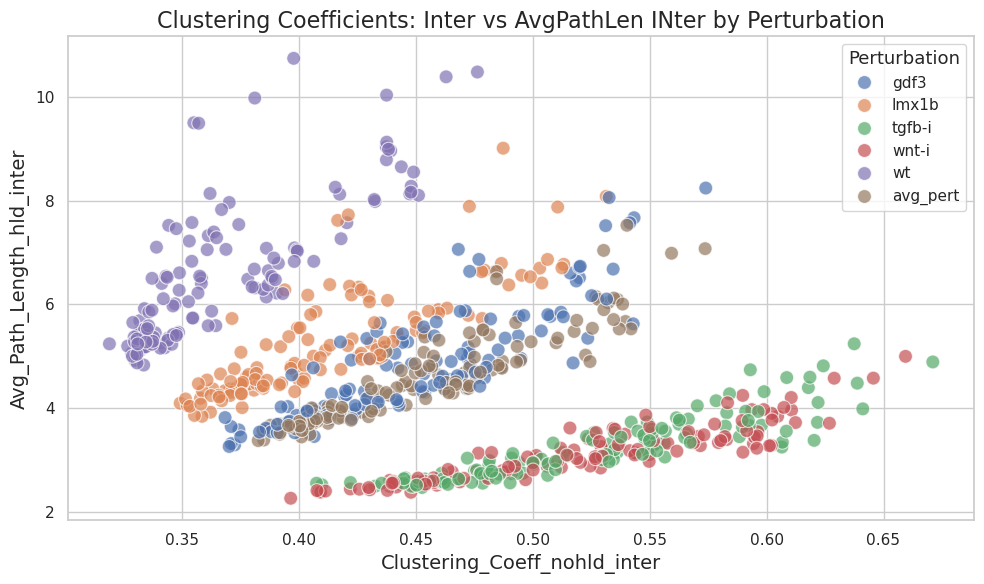

In [82]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming merged_df is already defined and loaded
# Example:
# merged_df = pd.read_csv('your_data.csv')

# Set the aesthetic style of the plots
sns.set(style="whitegrid")

# Create the scatter plot
plt.figure(figsize=(10, 6))
scatter_plot = sns.scatterplot(
    data=merged_df,
    x='Clustering_Coeff_nohld_inter',
    y='Avg_Path_Length_nohld_inter',
    hue='Perturbation',
    # palette='viridis',  # You can choose other palettes like 'deep', 'muted', etc.
    s=100,  # Size of the points
    alpha=0.7  # Transparency of the points
)

# Add title and labels
scatter_plot.set_title('Clustering Coefficients: Inter vs AvgPathLen INter by Perturbation', fontsize=16)
scatter_plot.set_xlabel('Clustering_Coeff_nohld_inter', fontsize=14)
scatter_plot.set_ylabel('Avg_Path_Length_hld_inter', fontsize=14)

# Improve legend
plt.legend(title='Perturbation', title_fontsize='13', fontsize='11')

# Show the plot
plt.tight_layout()
plt.show()

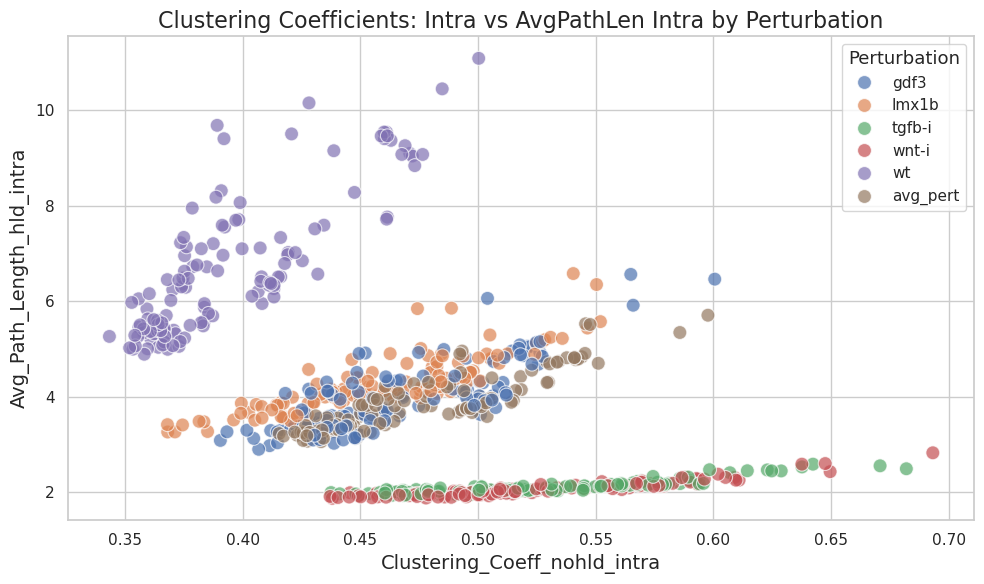

In [83]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

# Assuming merged_df is already defined and loaded
# Example:
# merged_df = pd.read_csv('your_data.csv')

# Set the aesthetic style of the plots
sns.set(style="whitegrid")

# Create the scatter plot
plt.figure(figsize=(10, 6))
scatter_plot = sns.scatterplot(
    data=merged_df,
    x='Clustering_Coeff_nohld_intra',
    y='Avg_Path_Length_nohld_intra',
    hue='Perturbation',
    # palette='viridis',  # You can choose other palettes like 'deep', 'muted', etc.
    s=100,  # Size of the points
    alpha=0.7  # Transparency of the points
)

# Add title and labels
scatter_plot.set_title('Clustering Coefficients: Intra vs AvgPathLen Intra by Perturbation', fontsize=16)
scatter_plot.set_xlabel('Clustering_Coeff_nohld_intra', fontsize=14)
scatter_plot.set_ylabel('Avg_Path_Length_hld_intra', fontsize=14)

# Improve legend
plt.legend(title='Perturbation', title_fontsize='13', fontsize='11')

# Show the plot
plt.tight_layout()
plt.show()

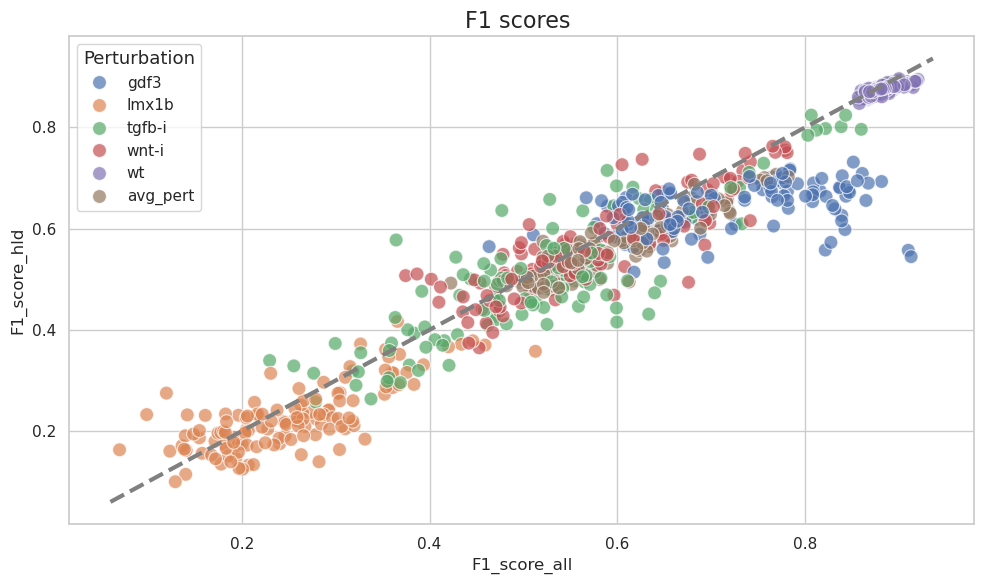

In [87]:
# Set the aesthetic style of the plots
sns.set(style="whitegrid")

# Create the scatter plot
plt.figure(figsize=(10, 6))
scatter_plot = sns.scatterplot(
    data=merged_df,
    x='F1_score_all',
    y='F1_score_hld',
    hue='Perturbation',
    # palette='viridis',  # You can choose other palettes like 'deep', 'muted', etc.
    s=100,  # Size of the points
    alpha=0.7  # Transparency of the points
)

# Add the x=y line
x_min, x_max = scatter_plot.get_xlim()
y_min, y_max = scatter_plot.get_ylim()
line_min, line_max = max(x_min, y_min), min(x_max, y_max)
plt.plot([line_min, line_max], [line_min, line_max], color='gray', linestyle='--', linewidth=3)

# Add title and labels
scatter_plot.set_title('F1 scores ', fontsize=16)
# scatter_plot.set_xlabel('Clustering_Coeff_nohld_intra', fontsize=14)
# scatter_plot.set_ylabel('Avg_Path_Length_hld_intra', fontsize=14)

# Improve legend
plt.legend(title='Perturbation', title_fontsize='13', fontsize='11')

# Show the plot
plt.tight_layout()
plt.show()

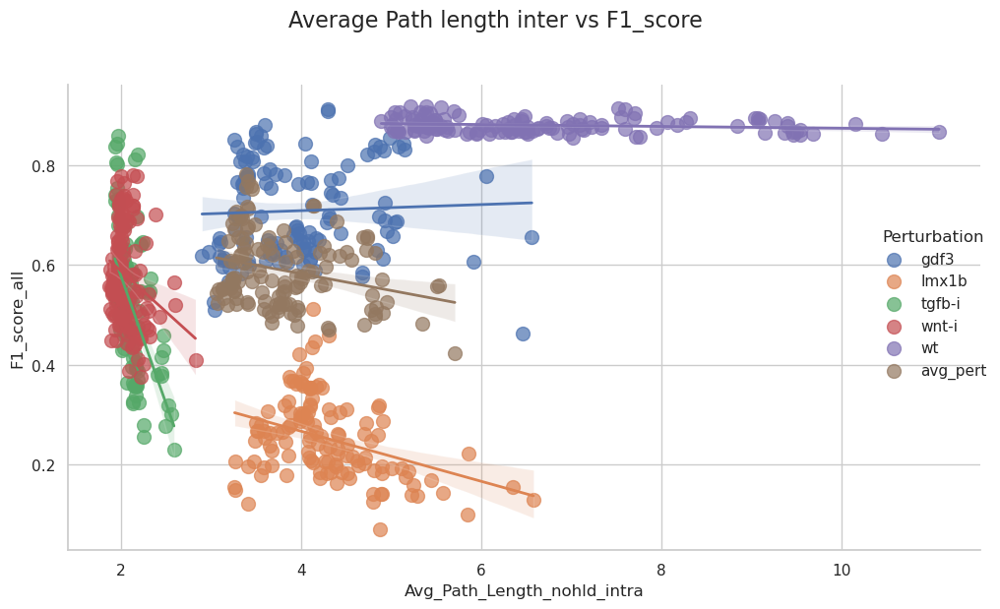

In [100]:
# Set the aesthetic style of the plots
sns.set(style="whitegrid")

# Create the scatter plot with trend lines
scatter_plot = sns.lmplot(
    data=merged_df,
    y='F1_score_all',
    x='Avg_Path_Length_nohld_intra',
    hue='Perturbation',
    scatter_kws={'s': 100, 'alpha': 0.7},  # Customize scatter points
    line_kws={'linewidth': 2},  # Customize trend lines
    height=6,  # Height of the plot
    aspect=1.5,  # Aspect ratio
)

# Add title to the plot
scatter_plot.fig.suptitle('Average Path length inter vs F1_score', fontsize=16, y=1.03)

# Adjust layout for the title to fit
plt.tight_layout()
plt.show()

<Figure size 1000x600 with 0 Axes>

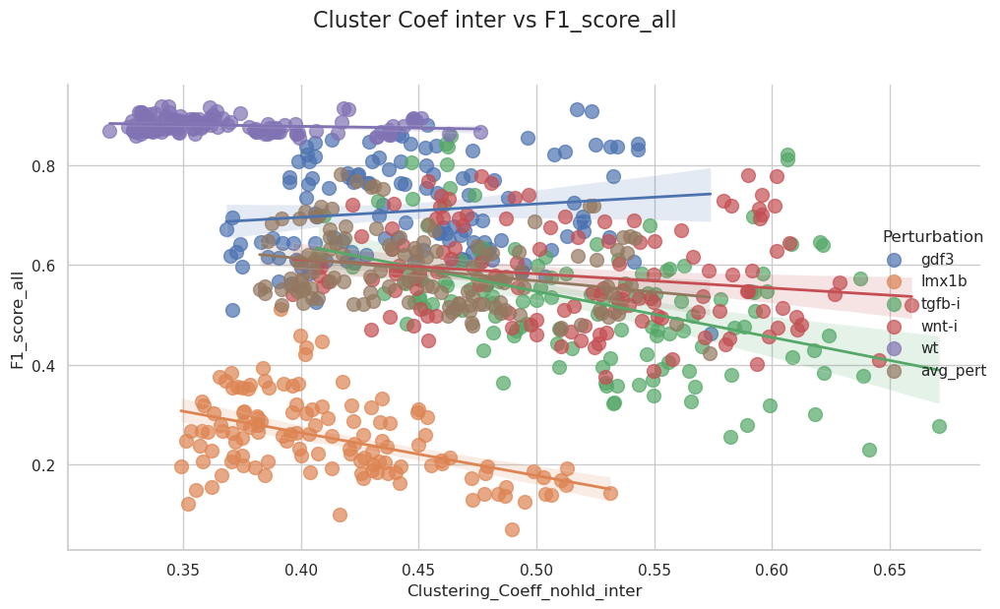

In [98]:
# Set the aesthetic style of the plots
sns.set(style="whitegrid")

# Create the scatter plot with trend lines
plt.figure(figsize=(10, 6))
scatter_plot = sns.lmplot(
    data=merged_df,
    y='F1_score_all',
    x='Clustering_Coeff_nohld_inter',
    hue='Perturbation',
    scatter_kws={'s': 100, 'alpha': 0.7},  # Customize scatter points
    line_kws={'linewidth': 2},  # Customize trend lines
    height=6,  # Height of the plot
    aspect=1.5  # Aspect ratio
)

# # Add title and labels
scatter_plot.fig.suptitle('Cluster Coef inter vs F1_score_all', fontsize=16, y=1.03)
# scatter_plot.fig.suptitle('F1 Scores with Trend Lines', fontsize=16)
# scatter_plot.set_axis_labels('F1_score_all', 'F1_score_hld', fontsize=14)

# Show the plot
plt.tight_layout()
plt.show()

<Figure size 1000x600 with 0 Axes>

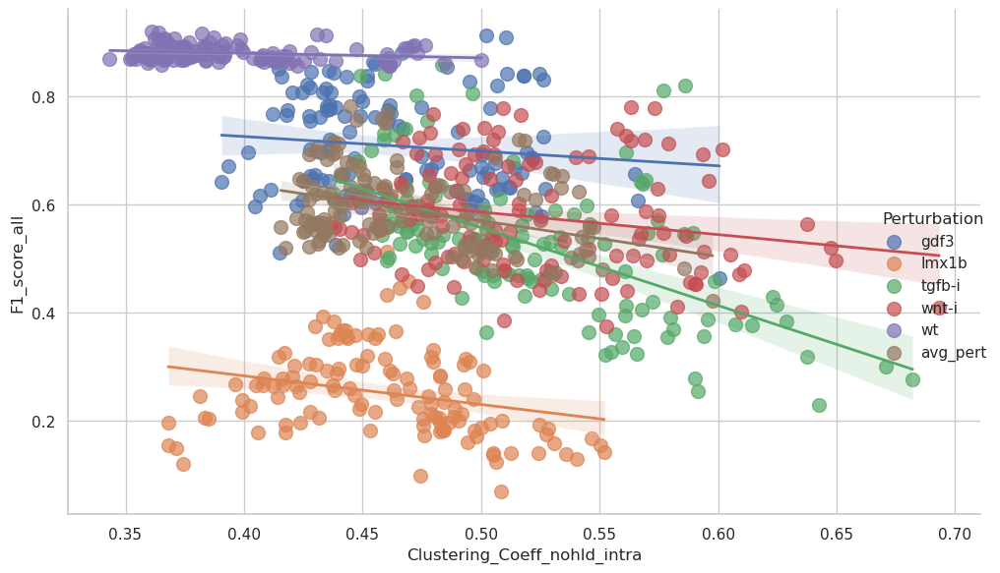

In [92]:
# Set the aesthetic style of the plots
sns.set(style="whitegrid")

# Create the scatter plot with trend lines
plt.figure(figsize=(10, 6))
scatter_plot = sns.lmplot(
    data=merged_df,
    y='F1_score_all',
    x='Clustering_Coeff_nohld_intra',
    hue='Perturbation',
    scatter_kws={'s': 100, 'alpha': 0.7},  # Customize scatter points
    line_kws={'linewidth': 2},  # Customize trend lines
    height=6,  # Height of the plot
    aspect=1.5  # Aspect ratio
)

# # Add title and labels
# scatter_plot.fig.suptitle('F1 Scores with Trend Lines', fontsize=16)
# scatter_plot.set_axis_labels('F1_score_all', 'F1_score_hld', fontsize=14)

# Show the plot
plt.tight_layout()
plt.show()

<Figure size 1000x600 with 0 Axes>

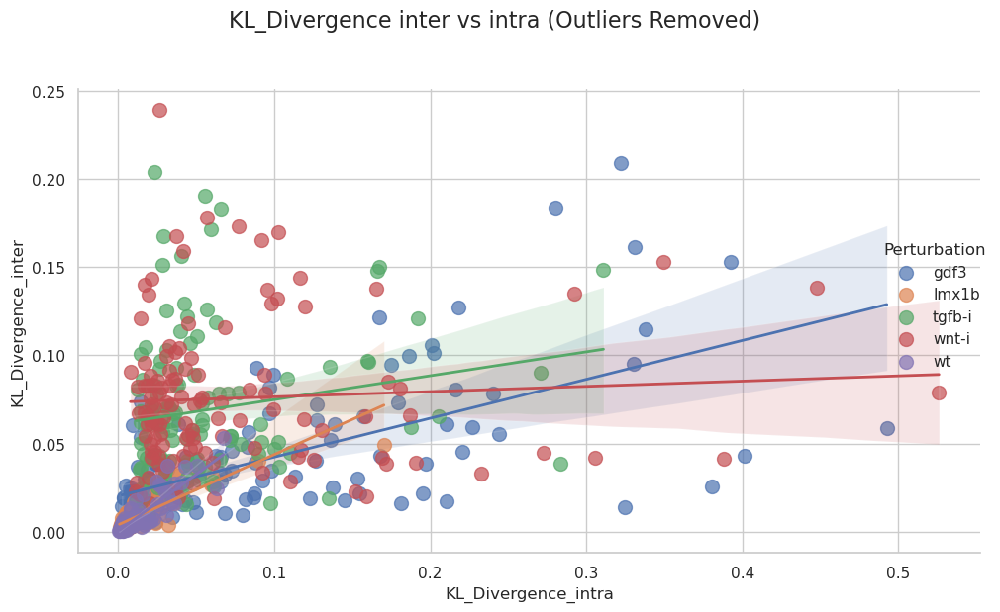

In [105]:
import numpy as np

# Define a function to remove outliers based on Z-score
def remove_outliers(df, columns, threshold=3):
    """
    Remove outliers from specified columns using Z-score method.
    """
    z_scores = np.abs((df[columns] - df[columns].mean()) / df[columns].std())
    return df[(z_scores < threshold).all(axis=1)]

# Remove outliers from the data
columns_to_check = ['KL_Divergence_inter', 'KL_Divergence_intra']
filtered_df = remove_outliers(merged_df, columns_to_check)
filtered_df = filtered_df[~filtered_df["Perturbation"].isin(["wnti-1","avg_pert"])]
# Recreate the scatter plot without outliers
sns.set(style="whitegrid")

plt.figure(figsize=(10, 6))
scatter_plot = sns.lmplot(
    data=filtered_df,
    y='KL_Divergence_inter',
    x='KL_Divergence_intra',
    hue='Perturbation',
    scatter_kws={'s': 100, 'alpha': 0.7},  # Customize scatter points
    line_kws={'linewidth': 2},  # Customize trend lines
    height=6,  # Height of the plot
    aspect=1.5  # Aspect ratio
)

# Add title and labels
scatter_plot.fig.suptitle('KL_Divergence inter vs intra (Outliers Removed)', fontsize=16, y=1.03)

# Show the plot
plt.tight_layout()
plt.show()


Jaccard Similarity_global

<Figure size 1000x600 with 0 Axes>

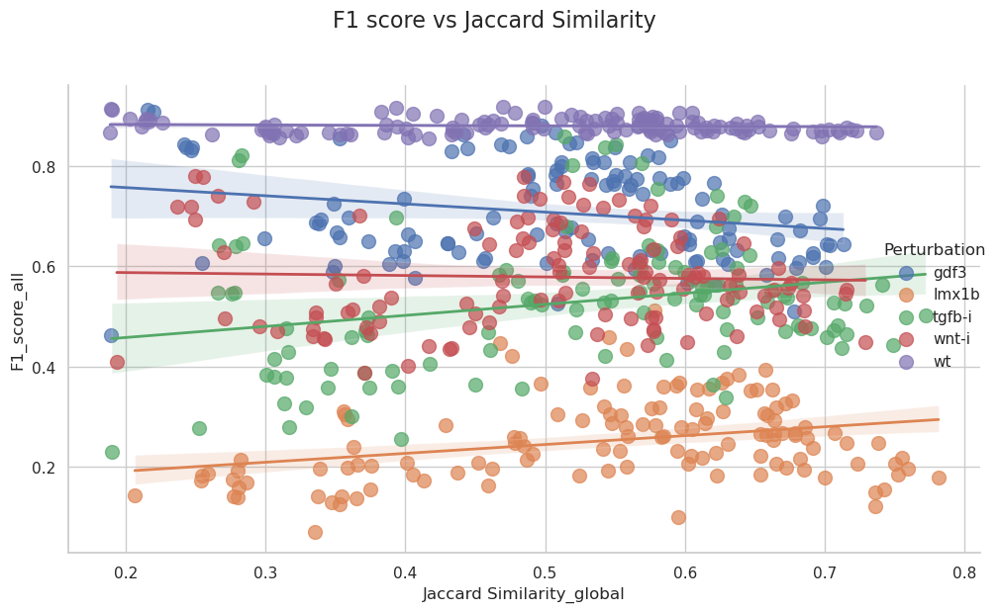

In [113]:
import numpy as np

# Define a function to remove outliers based on Z-score
def remove_outliers(df, columns, threshold=3):
    """
    Remove outliers from specified columns using Z-score method.
    """
    z_scores = np.abs((df[columns] - df[columns].mean()) / df[columns].std())
    return df[(z_scores < threshold).all(axis=1)]

# Remove outliers from the data

filtered_df = remove_outliers(merged_df, columns_to_check)
filtered_df = filtered_df[~filtered_df["Perturbation"].isin(["avg_pert"])]
# Recreate the scatter plot without outliers
sns.set(style="whitegrid")

plt.figure(figsize=(10, 6))
scatter_plot = sns.lmplot(
    data=filtered_df,
    x='Jaccard Similarity_global',
    y='F1_score_all',
    hue='Perturbation',
    scatter_kws={'s': 100, 'alpha': 0.7},  # Customize scatter points
    line_kws={'linewidth': 2},  # Customize trend lines
    height=6,  # Height of the plot
    aspect=1.5  # Aspect ratio
)

# Add title and labels
scatter_plot.fig.suptitle('F1 score vs Jaccard Similarity', fontsize=16, y=1.03)

# Show the plot
plt.tight_layout()
plt.show()


<Figure size 1000x600 with 0 Axes>

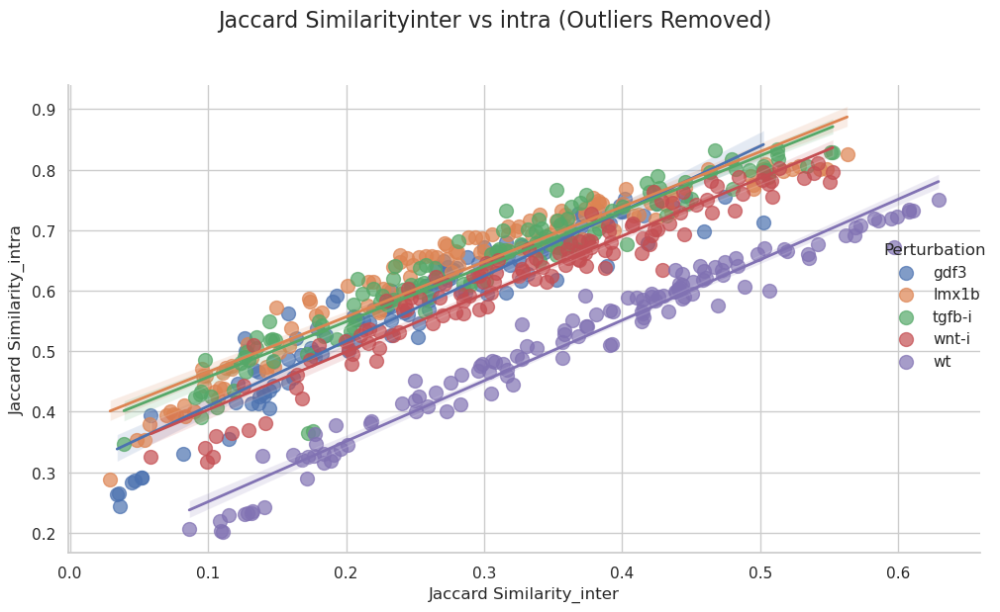

In [106]:
import numpy as np

# Define a function to remove outliers based on Z-score
def remove_outliers(df, columns, threshold=3):
    """
    Remove outliers from specified columns using Z-score method.
    """
    z_scores = np.abs((df[columns] - df[columns].mean()) / df[columns].std())
    return df[(z_scores < threshold).all(axis=1)]

# Remove outliers from the data
columns_to_check = ['KL_Divergence_inter', 'KL_Divergence_intra']
filtered_df = remove_outliers(merged_df, columns_to_check)
filtered_df = filtered_df[~filtered_df["Perturbation"].isin(["wnti-1","avg_pert"])]
# Recreate the scatter plot without outliers
sns.set(style="whitegrid")

plt.figure(figsize=(10, 6))
scatter_plot = sns.lmplot(
    data=filtered_df,
    y='Jaccard Similarity_intra',
    x='Jaccard Similarity_inter',
    hue='Perturbation',
    scatter_kws={'s': 100, 'alpha': 0.7},  # Customize scatter points
    line_kws={'linewidth': 2},  # Customize trend lines
    height=6,  # Height of the plot
    aspect=1.5  # Aspect ratio
)

# Add title and labels
scatter_plot.fig.suptitle('Jaccard Similarityinter vs intra (Outliers Removed)', fontsize=16, y=1.03)

# Show the plot
plt.tight_layout()
plt.show()


In [120]:
sel_models = merged_df_avg.sort_values(by="Jaccard Similarity_global", ascending=True)["model_index"].iloc[[1,-2]]
merged_df_avg[merged_df_avg["model_index"].isin(sel_models)][parameter_cols + ["F1_score_all","F1_score_hld", "Jaccard Similarity_global", "Clustering_Coeff_nohld_inter", "model_index", "Perturbation"]]

,metric_loss_type,margin,metric_weight,self_target_prob,time_only_flag,temperature,learning_rate,latent_dim,beta,batch_size,zn_frac,F1_score_all,F1_score_hld,Jaccard Similarity_global,Clustering_Coeff_nohld_inter,model_index,Perturbation
257,NT-Xent,1.0,50,0.5,1,0.1,0.0001,100,10.0,2048,0.2,0.657002,0.592749,0.239053,0.536915,52,avg_pert
515,triplet,0.1,10,0.5,0,0.1,0.0001,100,0.1,2048,0.2,0.544836,0.553666,0.727951,0.429211,108,avg_pert


In [116]:
for model_index in sel_models[0:2]:
    print(model_index)
    path = merged_df_avg[merged_df_avg["model_index"]==model_index]["embryo_df_path_nohld"].iloc[0]

    df_all = pd.read_csv(path)


    # Split the data
    df_all_train, df_all_test, df_all = split_train_test(df_all)


    # Define the comparisons (Multiclass) and obtain coloumns for data
    pert_comparisons = ["wnt-i", "tgfb-i", "wt", "lmx1b", "gdf3"]
    z_mu_columns = [col for col in df_all.columns if 'z_mu' in col]    
    z_mu_biological_columns = [col for col in z_mu_columns if "b" in col]

    # --- Example usage with logistic_regression_multiclass (all suffix) ---
    y_test_all, y_pred_proba_all, log_reg_all, train_df_all, test_df_all = logistic_regression_multiclass(
        df_all_train, df_all_test, z_mu_biological_columns, pert_comparisons,tol=.01)


    results_dict_all = f1_score_over_time_multiclass(y_test_all, y_pred_proba_all, test_df_all, pert_comparisons, num_bins=20, max_hpf=40)
    dataset_label = 'all_perts_F1'
    # plot_f1_score_over_time(results_dict_all, pert_comparisons, dataset_label=dataset_label, title="F1 Score Over Time for Perturbations")



    import pandas as pd
    import numpy as np
    import plotly.express as px
    from sklearn.decomposition import PCA


    # Assuming you have a dataframe 'test_df' with the necessary columns
    fig = plot_pca_highlighted_embryos(
        test_df=test_df_all,
        z_mu_biological_columns=z_mu_biological_columns,  # replace with your actual columns
        downsample_wt=True,
        wt_downsample_frac=0.1,  # Adjust the fraction as needed
        marker_size=2,
    )



42


/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/763530658.py:5: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.

/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/235232

52


/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/763530658.py:5: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.

/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/235232

In [125]:
for model_index in sel_models[0:1]:
    print(model_index)

    path_all = merged_df_avg[merged_df_avg["model_index"]==model_index]["embryo_df_path_nohld"].iloc[0]
    df_all = pd.read_csv(path_all)

    path_hld = merged_df_avg[merged_df_avg["model_index"]==model_index]["embryo_df_path_hld"].iloc[0]
    df_hld = pd.read_csv(path_hld)


    # Split the data
    df_all_train, df_all_test, df_all = split_train_test(df_all)
    df_hld_train, df_hld_test, df_hld = split_train_test(df_hld)


    # Define the comparisons (Multiclass) and obtain coloumns for data
    pert_comparisons = ["wnt-i", "tgfb-i", "wt", "lmx1b", "gdf3"]
    z_mu_columns = [col for col in df_all.columns if 'z_mu' in col]    
    z_mu_biological_columns = [col for col in z_mu_columns if "b" in col]

    # --- Example usage with logistic_regression_multiclass (all suffix) ---
    y_test_all, y_pred_proba_all, log_reg_all, train_df_all, test_df_all = logistic_regression_multiclass(
        df_all_train, df_all_test, z_mu_biological_columns, pert_comparisons,tol=.01)

        # --- Example usage with logistic_regression_multiclass (all suffix) ---
    y_test_hld, y_pred_proba_hld, log_reg_hld, train_df_hld, test_df_hld = logistic_regression_multiclass(
        df_hld_train, df_hld_test, z_mu_biological_columns, pert_comparisons,tol=.01)


    # results_dict_all = f1_score_over_time_multiclass(y_test_all, y_pred_proba_all, test_df_all, pert_comparisons, num_bins=20, max_hpf=40)
    # dataset_label = 'all_perts_F1'
    # # plot_f1_score_over_time(results_dict_all, pert_comparisons, dataset_label=dataset_label, title="F1 Score Over Time for Perturbations")
    # # plot_f1_score_over_time(results_dict_all, pert_comparisons, dataset_label=dataset_label, title="F1 Score Over Time for Perturbations")



    import pandas as pd
    import numpy as np
    import plotly.express as px
    from sklearn.decomposition import PCA


    # Assuming you have a dataframe 'test_df' with the necessary columns
    fig = plot_pca_highlighted_embryos(
        test_df=test_df_all,
        z_mu_biological_columns=z_mu_biological_columns,  # replace with your actual columns
        downsample_wt=True,
        wt_downsample_frac=0.1,  # Adjust the fraction as needed
        marker_size=2,
    )


    # Assuming you have a dataframe 'test_df' with the necessary columns
    fig = plot_pca_highlighted_embryos(
        test_df=test_df_hld,
        z_mu_biological_columns=z_mu_biological_columns,  # replace with your actual columns
        downsample_wt=True,
        wt_downsample_frac=0.1,  # Adjust the fraction as needed
        marker_size=2,
    )



52


/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2675112801.py:5: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.

/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2675112801.py:8: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.

/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the doc

/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2352327494.py:76: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2352327494.py:77: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2352327494.py:76: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

In [126]:
for model_index in sel_models[1:2]:
    print(model_index)

    path_all = merged_df_avg[merged_df_avg["model_index"]==model_index]["embryo_df_path_nohld"].iloc[0]
    df_all = pd.read_csv(path_all)

    path_hld = merged_df_avg[merged_df_avg["model_index"]==model_index]["embryo_df_path_hld"].iloc[0]
    df_hld = pd.read_csv(path_hld)


    # Split the data
    df_all_train, df_all_test, df_all = split_train_test(df_all)
    df_hld_train, df_hld_test, df_hld = split_train_test(df_hld)


    # Define the comparisons (Multiclass) and obtain coloumns for data
    pert_comparisons = ["wnt-i", "tgfb-i", "wt", "lmx1b", "gdf3"]
    z_mu_columns = [col for col in df_all.columns if 'z_mu' in col]    
    z_mu_biological_columns = [col for col in z_mu_columns if "b" in col]

    # --- Example usage with logistic_regression_multiclass (all suffix) ---
    y_test_all, y_pred_proba_all, log_reg_all, train_df_all, test_df_all = logistic_regression_multiclass(
        df_all_train, df_all_test, z_mu_biological_columns, pert_comparisons,tol=.01)

        # --- Example usage with logistic_regression_multiclass (all suffix) ---
    y_test_hld, y_pred_proba_hld, log_reg_hld, train_df_hld, test_df_hld = logistic_regression_multiclass(
        df_hld_train, df_hld_test, z_mu_biological_columns, pert_comparisons,tol=.01)


    # results_dict_all = f1_score_over_time_multiclass(y_test_all, y_pred_proba_all, test_df_all, pert_comparisons, num_bins=20, max_hpf=40)
    # dataset_label = 'all_perts_F1'
    # # plot_f1_score_over_time(results_dict_all, pert_comparisons, dataset_label=dataset_label, title="F1 Score Over Time for Perturbations")
    # # plot_f1_score_over_time(results_dict_all, pert_comparisons, dataset_label=dataset_label, title="F1 Score Over Time for Perturbations")



    import pandas as pd
    import numpy as np
    import plotly.express as px
    from sklearn.decomposition import PCA


    # Assuming you have a dataframe 'test_df' with the necessary columns
    fig = plot_pca_highlighted_embryos(
        test_df=test_df_all,
        z_mu_biological_columns=z_mu_biological_columns,  # replace with your actual columns
        downsample_wt=True,
        wt_downsample_frac=0.1,  # Adjust the fraction as needed
        marker_size=2,
    )


    # Assuming you have a dataframe 'test_df' with the necessary columns
    fig = plot_pca_highlighted_embryos(
        test_df=test_df_hld,
        z_mu_biological_columns=z_mu_biological_columns,  # replace with your actual columns
        downsample_wt=True,
        wt_downsample_frac=0.1,  # Adjust the fraction as needed
        marker_size=2,
    )



108


/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2573390756.py:5: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.

/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2573390756.py:8: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.

/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the doc

/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2352327494.py:76: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2352327494.py:77: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2352327494.py:76: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

<Figure size 1000x600 with 0 Axes>

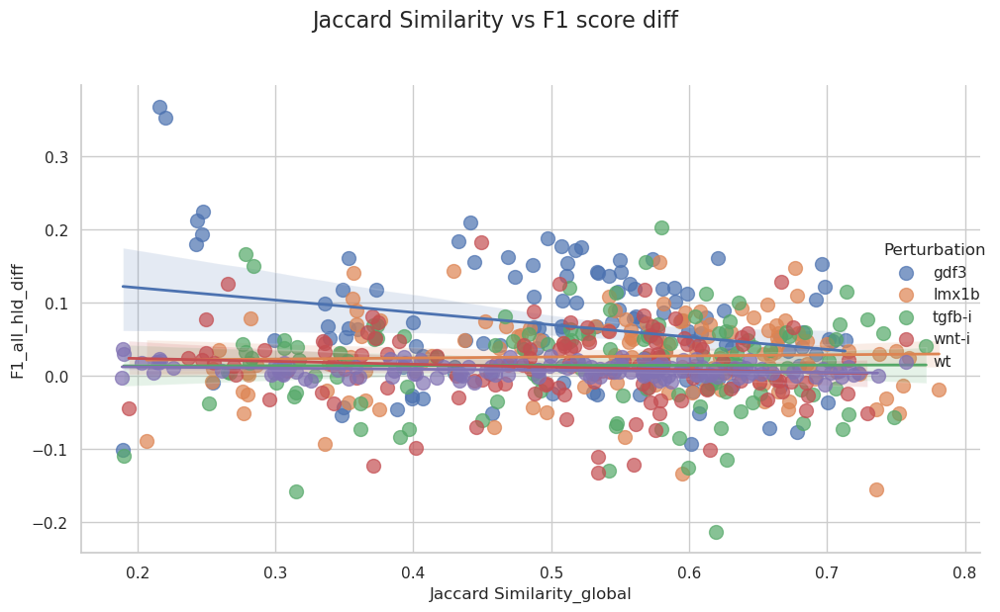

In [127]:
import numpy as np

# Define a function to remove outliers based on Z-score
def remove_outliers(df, columns, threshold=3):
    """
    Remove outliers from specified columns using Z-score method.
    """
    z_scores = np.abs((df[columns] - df[columns].mean()) / df[columns].std())
    return df[(z_scores < threshold).all(axis=1)]

# Remove outliers from the data
columns_to_check = ['KL_Divergence_inter', 'KL_Divergence_intra']
filtered_df = remove_outliers(merged_df, columns_to_check)
filtered_df = filtered_df[~filtered_df["Perturbation"].isin(["wnti-1","avg_pert"])]
# Recreate the scatter plot without outliers
sns.set(style="whitegrid")

plt.figure(figsize=(10, 6))
scatter_plot = sns.lmplot(
    data=filtered_df,
    y='F1_all_hld_diff',
    x='Jaccard Similarity_global',
    hue='Perturbation',
    scatter_kws={'s': 100, 'alpha': 0.7},  # Customize scatter points
    line_kws={'linewidth': 2},  # Customize trend lines
    height=6,  # Height of the plot
    aspect=1.5  # Aspect ratio
)

# Add title and labels
scatter_plot.fig.suptitle('Jaccard Similarity vs F1 score diff', fontsize=16, y=1.03)

# Show the plot
plt.tight_layout()
plt.show()


In [131]:
sel_models = merged_df_avg.sort_values(by="F1_all_hld_diff", ascending=True)["model_index"].iloc[[24,-1]]
merged_df_avg[merged_df_avg["model_index"].isin(sel_models)][parameter_cols + ["F1_score_all","F1_score_hld", "Clustering_Coeff_nohld_inter", "model_index", "Perturbation"]]

,metric_loss_type,margin,metric_weight,self_target_prob,time_only_flag,temperature,learning_rate,latent_dim,beta,batch_size,zn_frac,F1_score_all,F1_score_hld,Clustering_Coeff_nohld_inter,model_index,Perturbation
197,NT-Xent,1.0,25,0.50,0,0.1,0.0001,100,1.0,2048,0.2,0.720055,0.630332,0.524395,40,avg_pert
365,NT-Xent,2.0,50,0.25,0,0.1,0.0001,100,10.0,2048,0.2,0.545904,0.545571,0.459637,74,avg_pert


In [ ]:
for model_index in sel_models[0:1]:
    print(model_index)

    path_all = merged_df_avg[merged_df_avg["model_index"]==model_index]["embryo_df_path_nohld"].iloc[0]
    df_all = pd.read_csv(path_all)

    path_hld = merged_df_avg[merged_df_avg["model_index"]==model_index]["embryo_df_path_hld"].iloc[0]
    df_hld = pd.read_csv(path_hld)


    # Split the data
    df_all_train, df_all_test, df_all = split_train_test(df_all)
    df_hld_train, df_hld_test, df_hld = split_train_test(df_hld)


    # Define the comparisons (Multiclass) and obtain coloumns for data
    pert_comparisons = ["wnt-i", "tgfb-i", "wt", "lmx1b", "gdf3"]
    z_mu_columns = [col for col in df_all.columns if 'z_mu' in col]    
    z_mu_biological_columns = [col for col in z_mu_columns if "b" in col]

    # --- Example usage with logistic_regression_multiclass (all suffix) ---
    y_test_all, y_pred_proba_all, log_reg_all, train_df_all, test_df_all = logistic_regression_multiclass(
        df_all_train, df_all_test, z_mu_biological_columns, pert_comparisons,tol=.01)

        # --- Example usage with logistic_regression_multiclass (all suffix) ---
    y_test_hld, y_pred_proba_hld, log_reg_hld, train_df_hld, test_df_hld = logistic_regression_multiclass(
        df_hld_train, df_hld_test, z_mu_biological_columns, pert_comparisons,tol=.01)


    # results_dict_all = f1_score_over_time_multiclass(y_test_all, y_pred_proba_all, test_df_all, pert_comparisons, num_bins=20, max_hpf=40)
    # dataset_label = 'all_perts_F1'
    # # plot_f1_score_over_time(results_dict_all, pert_comparisons, dataset_label=dataset_label, title="F1 Score Over Time for Perturbations")
    # # plot_f1_score_over_time(results_dict_all, pert_comparisons, dataset_label=dataset_label, title="F1 Score Over Time for Perturbations")



    import pandas as pd
    import numpy as np
    import plotly.express as px
    from sklearn.decomposition import PCA


    # Assuming you have a dataframe 'test_df' with the necessary columns
    fig = plot_pca_highlighted_embryos(
        test_df=test_df_all,
        z_mu_biological_columns=z_mu_biological_columns,  # replace with your actual columns
        downsample_wt=True,
        wt_downsample_frac=0.1,  # Adjust the fraction as needed
        marker_size=2,
    )


    # Assuming you have a dataframe 'test_df' with the necessary columns
    fig = plot_pca_highlighted_embryos(
        test_df=test_df_hld,
        z_mu_biological_columns=z_mu_biological_columns,  # replace with your actual columns
        downsample_wt=True,
        wt_downsample_frac=0.1,  # Adjust the fraction as needed
        marker_size=2,
    )



74


/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2675112801.py:5: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.

/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2675112801.py:8: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.

/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the doc

In [133]:
for model_index in sel_models[1:2]:
    print(model_index)

    path_all = merged_df_avg[merged_df_avg["model_index"]==model_index]["embryo_df_path_nohld"].iloc[0]
    df_all = pd.read_csv(path_all)

    path_hld = merged_df_avg[merged_df_avg["model_index"]==model_index]["embryo_df_path_hld"].iloc[0]
    df_hld = pd.read_csv(path_hld)


    # Split the data
    df_all_train, df_all_test, df_all = split_train_test(df_all)
    df_hld_train, df_hld_test, df_hld = split_train_test(df_hld)


    # Define the comparisons (Multiclass) and obtain coloumns for data
    pert_comparisons = ["wnt-i", "tgfb-i", "wt", "lmx1b", "gdf3"]
    z_mu_columns = [col for col in df_all.columns if 'z_mu' in col]    
    z_mu_biological_columns = [col for col in z_mu_columns if "b" in col]

    # --- Example usage with logistic_regression_multiclass (all suffix) ---
    y_test_all, y_pred_proba_all, log_reg_all, train_df_all, test_df_all = logistic_regression_multiclass(
        df_all_train, df_all_test, z_mu_biological_columns, pert_comparisons,tol=.01)

        # --- Example usage with logistic_regression_multiclass (all suffix) ---
    y_test_hld, y_pred_proba_hld, log_reg_hld, train_df_hld, test_df_hld = logistic_regression_multiclass(
        df_hld_train, df_hld_test, z_mu_biological_columns, pert_comparisons,tol=.01)


    # results_dict_all = f1_score_over_time_multiclass(y_test_all, y_pred_proba_all, test_df_all, pert_comparisons, num_bins=20, max_hpf=40)
    # dataset_label = 'all_perts_F1'
    # # plot_f1_score_over_time(results_dict_all, pert_comparisons, dataset_label=dataset_label, title="F1 Score Over Time for Perturbations")
    # # plot_f1_score_over_time(results_dict_all, pert_comparisons, dataset_label=dataset_label, title="F1 Score Over Time for Perturbations")



    import pandas as pd
    import numpy as np
    import plotly.express as px
    from sklearn.decomposition import PCA


    # Assuming you have a dataframe 'test_df' with the necessary columns
    fig = plot_pca_highlighted_embryos(
        test_df=test_df_all,
        z_mu_biological_columns=z_mu_biological_columns,  # replace with your actual columns
        downsample_wt=True,
        wt_downsample_frac=0.1,  # Adjust the fraction as needed
        marker_size=2,
    )


    # Assuming you have a dataframe 'test_df' with the necessary columns
    fig = plot_pca_highlighted_embryos(
        test_df=test_df_hld,
        z_mu_biological_columns=z_mu_biological_columns,  # replace with your actual columns
        downsample_wt=True,
        wt_downsample_frac=0.1,  # Adjust the fraction as needed
        marker_size=2,
    )



40


/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2573390756.py:5: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.

/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2573390756.py:8: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.

/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:115: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/net/trapnell/vol1/home/mdcolon/proj/morphseq/src/functions/embryo_df_performance_metrics.py:116: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the doc

/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2352327494.py:76: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2352327494.py:77: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2352327494.py:76: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

In [ ]:
sel_models = merged_df_avg.sort_values(by="F1_all_hld_diff", ascending=True)["model_index"].iloc[[24,-1]]
merged_df_avg[merged_df_avg["model_index"].isin(sel_models)][parameter_cols + ["F1_score_all","F1_score_hld", "Clustering_Coeff_nohld_inter", "model_index", "Perturbation"]]

In [ ]:
import numpy as np
import pandas as pd
import plotly.express as px
from sklearn.decomposition import PCA

def plot_pca_2d_highlighted_embryos(
    test_df,
    z_mu_biological_columns,
    perturbations=None,
    highlight_embryos=None,
    highlight_colors=None,
    marker_size=5,
    highlight_marker_size=10,
    opacity=0.7,
    title="2D PCA Plot",
    show_legend=True,
    plot=True,
    downsample_wt=False,
    wt_downsample_frac=0.1,
    random_state=42
):
    # Copy the dataframe to avoid modifying the original data
    df = test_df.copy()

    # Downsample wild-type data if enabled
    if downsample_wt:
        # Identify wild-type entries (assuming 'phenotype' column indicates perturbation status)
        wt_mask = df['phenotype'] == 'wt'
        wt_df = df[wt_mask]
        perturbed_df = df[~wt_mask]

        # Get unique embryo_ids for wild-type
        unique_wt_embryos = wt_df['embryo_id'].unique()

        # Calculate the number of embryos to sample
        n_sample = max(1, int(len(unique_wt_embryos) * wt_downsample_frac))

        # Randomly sample embryo_ids
        sampled_embryos = np.random.RandomState(random_state).choice(
            unique_wt_embryos, size=n_sample, replace=False
        )

        # Filter the wild-type dataframe
        wt_df_sampled = wt_df[wt_df['embryo_id'].isin(sampled_embryos)]

        # Combine back with perturbed data
        df = pd.concat([wt_df_sampled, perturbed_df], ignore_index=True)
    
    # Prepare data for PCA
    X = df[z_mu_biological_columns].values

    # Perform PCA with 2 components
    pca = PCA(n_components=2)
    pcs = pca.fit_transform(X)
    df_pca = pd.DataFrame(pcs, columns=['PC1', 'PC2'])
    df_pca = pd.concat([df.reset_index(drop=True), df_pca], axis=1)

    # Prepare color and size settings
    if perturbations is None:
        perturbations = df_pca['phenotype'].unique()
    color_discrete_map = {pert: px.colors.qualitative.Plotly[i % 10] for i, pert in enumerate(perturbations)}
    
    # Handle embryo highlighting
    df_pca['marker_size'] = marker_size
    df_pca['opacity'] = opacity
    df_pca['color'] = df_pca['phenotype'].map(color_discrete_map)

    if highlight_embryos:
        if highlight_colors is None:
            highlight_colors = ['red'] * len(highlight_embryos)
        highlight_dict = dict(zip(highlight_embryos, highlight_colors))
        df_pca.loc[df_pca['embryo_id'].isin(highlight_embryos), 'marker_size'] = highlight_marker_size
        df_pca.loc[df_pca['embryo_id'].isin(highlight_embryos), 'color'] = df_pca['embryo_id'].map(highlight_dict)
        # df_pca.loc[df_pca['embryo_id'].isin(highlight_embryos), 'opacity'] = 1.0

    # if plot:
    #     fig = px.scatter(
    #         df_pca,
    #         x='PC1',
    #         y='PC2',
    #         color='phenotype',
    #         # symbol='phenotype',
    #         size='marker_size',
    #         opacity=opacity,
    #         color_discrete_map=color_discrete_map,
    #         title=title
    #     )

    if plot:
        fig = px.scatter_3d(
            df_pca,
            x='PC1',
            y='PC2',
            z='PC3',
            color='phenotype',
            symbol='phenotype',
            size='marker_size',
            opacity=opacity,
            color_discrete_map=color_discrete_map,
            title=title
        )


        if not show_legend:
            fig.update_layout(showlegend=False)

        fig.show()

    return fig

# Assuming you have a dataframe 'test_df' with the necessary columns
fig = plot_pca_2d_highlighted_embryos(
    test_df=test_df_all,
    z_mu_biological_columns=z_mu_biological_columns,  # replace with your actual columns
    downsample_wt=True,
    wt_downsample_frac=0.1,  # Adjust the fraction as needed
    marker_size=2,
)

fig = plot_pca_highlighted_embryos(
    test_df=test_df_all,
    z_mu_biological_columns=z_mu_biological_columns,  # replace with your actual columns
    downsample_wt=True,
    wt_downsample_frac=0.1,  # Adjust the fraction as needed
    marker_size=2,
)

    # Assu

/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2352327494.py:76: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2352327494.py:77: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2352327494.py:76: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pa

In [163]:
sel_models = merged_df_avg.sort_values(by="F1_score_all", ascending=False)["model_index"].iloc[0:10]
merged_df_avg[merged_df_avg["model_index"].isin(sel_models)][parameter_cols + ["F1_score_all","F1_score_hld", "Clustering_Coeff_nohld_inter", "model_index", "Perturbation"]]

,metric_loss_type,margin,metric_weight,self_target_prob,time_only_flag,temperature,learning_rate,latent_dim,beta,batch_size,zn_frac,F1_score_all,F1_score_hld,Clustering_Coeff_nohld_inter,model_index,Perturbation
47,NT-Xent,0.1,10,0.75,0,0.1,0.0001,100,10.0,2048,0.2,0.716457,0.651946,0.408464,8,avg_pert
83,NT-Xent,0.1,25,0.50,1,0.1,0.0001,100,0.1,2048,0.2,0.769058,0.707290,0.423525,15,avg_pert
89,NT-Xent,0.1,25,0.50,1,0.1,0.0001,100,1.0,2048,0.2,0.719329,0.633751,0.522497,16,avg_pert
185,NT-Xent,1.0,25,0.25,0,0.1,0.0001,100,10.0,2048,0.2,0.756505,0.700733,0.429632,38,avg_pert
191,NT-Xent,1.0,25,0.50,0,0.1,0.0001,100,0.1,2048,0.2,0.752269,0.695757,0.434678,39,avg_pert
197,NT-Xent,1.0,25,0.50,0,0.1,0.0001,100,1.0,2048,0.2,0.720055,0.630332,0.524395,40,avg_pert
215,NT-Xent,1.0,25,0.50,1,0.1,0.0001,100,10.0,2048,0.2,0.707447,0.658815,0.401733,43,avg_pert
347,NT-Xent,2.0,25,0.50,1,0.1,0.0001,100,10.0,2048,0.2,0.713932,0.645467,0.413150,71,avg_pert
377,NT-Xent,2.0,50,0.50,0,0.1,0.0001,100,10.0,2048,0.2,0.781858,0.702657,0.416876,77,avg_pert
383,NT-Xent,2.0,50,0.50,1,0.1,0.0001,100,0.1,2048,0.2,0.759139,0.694277,0.430906,78,avg_pert


/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2267240185.py:27: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2267240185.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



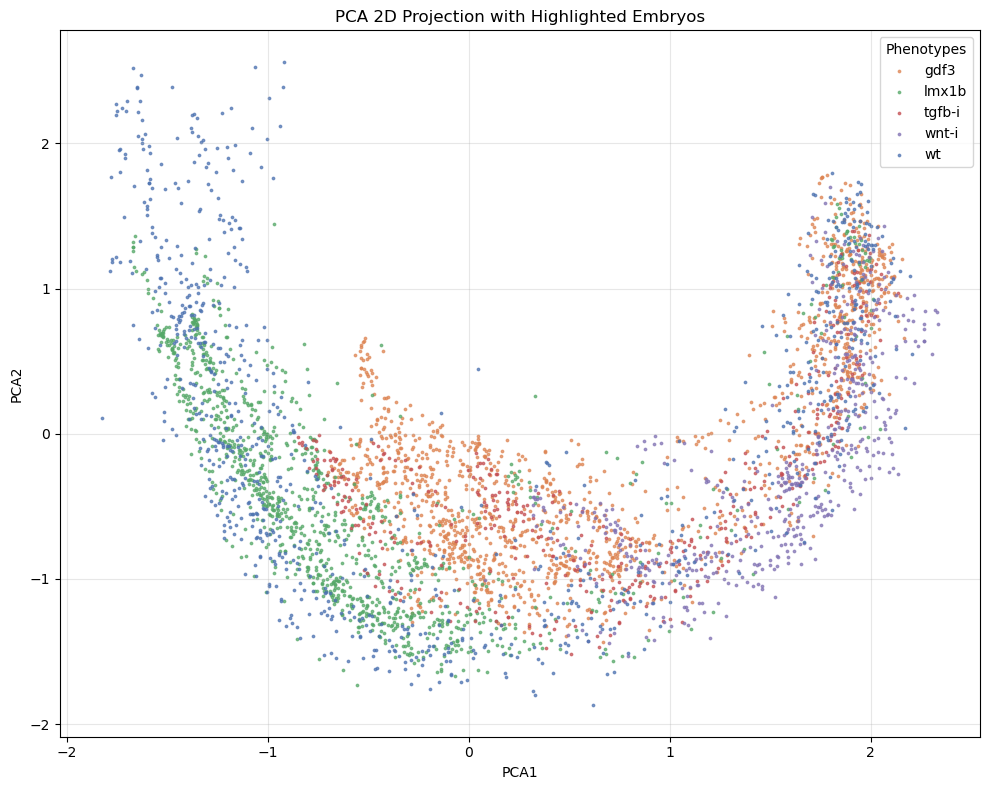

In [195]:
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
import numpy as np
import seaborn as sns

plt.style.use('default')

def plot_pca_2d_highlighted_embryos_matplotlib(test_df, z_mu_biological_columns, downsample_wt=False, wt_downsample_frac=0.1, marker_size=3, pert_comparisons=pert_comparisons,title=None):
    """
    Plots a 2D PCA projection of the data with wild-type embryos optionally downsampled.
    
    Parameters:
        test_df (pd.DataFrame): Test dataset.
        z_mu_biological_columns (list): Columns representing latent variables.
        downsample_wt (bool): Whether to downsample wild-type data.
        wt_downsample_frac (float): Fraction of wild-type data to keep if downsampling.
        marker_size (int): Size of the scatterplot markers.
        pert_comparisons (list): List of phenotypes to include in the plot.
    """
    # Perform PCA
    pca = PCA(n_components=2)
    if pert_comparisons:
        test_df = test_df[test_df["phenotype"].isin(pert_comparisons)]
    pca_result = pca.fit_transform(test_df[z_mu_biological_columns])

    # Add PCA columns to the dataframe
    test_df['PCA1'] = pca_result[:, 0]
    test_df['PCA2'] = pca_result[:, 1]

    # Optional: Downsample wild-type embryos
    if downsample_wt:
        wt_mask = test_df['phenotype'] == 'wt'
        non_wt_df = test_df[~wt_mask]
        wt_df = test_df[wt_mask].sample(frac=wt_downsample_frac, random_state=42)
        test_df = pd.concat([wt_df, non_wt_df])

    # Get unique phenotypes and assign seaborn colors
    unique_phenotypes = test_df['phenotype'].unique()
    palette = sns.color_palette("deep", len(unique_phenotypes))
    color_map = dict(zip(unique_phenotypes, palette))
    test_df['color'] = test_df['phenotype'].map(color_map)

    # Plot the data
    plt.figure(figsize=(10, 8))
    for phenotype, group_df in test_df.groupby('phenotype'):
        plt.scatter(
            group_df['PCA1'], 
            group_df['PCA2'], 
            c=[color_map[phenotype]], 
            label=phenotype, 
            s=marker_size, 
            alpha=0.7
        )

    # Add a legend
    plt.legend(title="Phenotypes")
    if title:
        plt.title(title)
    else:
        plt.title('PCA 2D Projection with Highlighted Embryos')
    plt.xlabel('PCA1')
    plt.ylabel('PCA2')
    plt.grid(alpha=0.3)
    plt.tight_layout()

    # Show the plot
    plt.show()

# Call the function
plot_pca_2d_highlighted_embryos_matplotlib(
    test_df=df_all_test,
    z_mu_biological_columns=z_mu_biological_columns,  # Replace with your actual column names
    downsample_wt=True,
    wt_downsample_frac=0.1,  # Adjust as needed
    marker_size=3, # Replace with relevant comparisons
)

In [194]:
sel_models = merged_df_avg.sort_values(by="F1_score_all", ascending=False)["model_index"].iloc[0:10]
merged_df_avg[merged_df_avg["model_index"].isin(sel_models)][parameter_cols + ["F1_score_all","F1_score_hld", "Clustering_Coeff_nohld_inter", "model_index", "Perturbation"]]

,metric_loss_type,margin,metric_weight,self_target_prob,time_only_flag,temperature,learning_rate,latent_dim,beta,batch_size,zn_frac,F1_score_all,F1_score_hld,Clustering_Coeff_nohld_inter,model_index,Perturbation
47,NT-Xent,0.1,10,0.75,0,0.1,0.0001,100,10.0,2048,0.2,0.716457,0.651946,0.408464,8,avg_pert
83,NT-Xent,0.1,25,0.50,1,0.1,0.0001,100,0.1,2048,0.2,0.769058,0.707290,0.423525,15,avg_pert
89,NT-Xent,0.1,25,0.50,1,0.1,0.0001,100,1.0,2048,0.2,0.719329,0.633751,0.522497,16,avg_pert
185,NT-Xent,1.0,25,0.25,0,0.1,0.0001,100,10.0,2048,0.2,0.756505,0.700733,0.429632,38,avg_pert
191,NT-Xent,1.0,25,0.50,0,0.1,0.0001,100,0.1,2048,0.2,0.752269,0.695757,0.434678,39,avg_pert
197,NT-Xent,1.0,25,0.50,0,0.1,0.0001,100,1.0,2048,0.2,0.720055,0.630332,0.524395,40,avg_pert
215,NT-Xent,1.0,25,0.50,1,0.1,0.0001,100,10.0,2048,0.2,0.707447,0.658815,0.401733,43,avg_pert
347,NT-Xent,2.0,25,0.50,1,0.1,0.0001,100,10.0,2048,0.2,0.713932,0.645467,0.413150,71,avg_pert
377,NT-Xent,2.0,50,0.50,0,0.1,0.0001,100,10.0,2048,0.2,0.781858,0.702657,0.416876,77,avg_pert
383,NT-Xent,2.0,50,0.50,1,0.1,0.0001,100,0.1,2048,0.2,0.759139,0.694277,0.430906,78,avg_pert


77
0.7818578623821643


/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/1351566007.py:10: DtypeWarning:

Columns (2) have mixed types. Specify dtype option on import or set low_memory=False.

/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2267240185.py:27: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/6708621.1.trapnell-login.q/ipykernel_3607973/2267240185.py:28: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



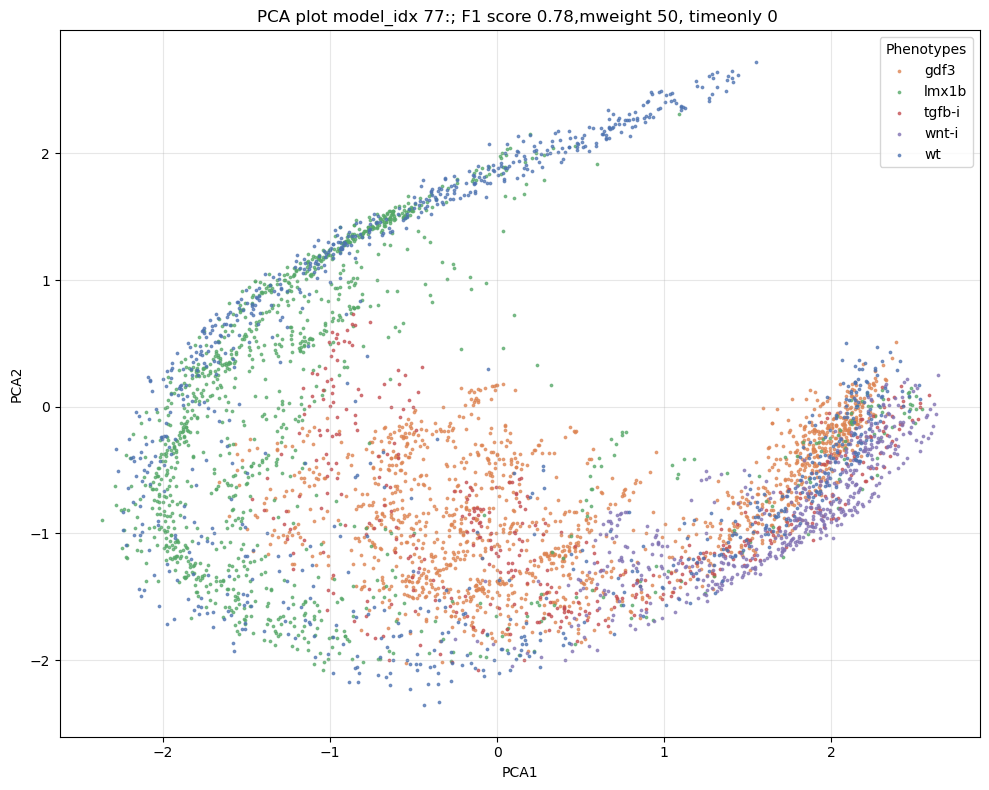

In [ ]:
for model_index in sel_models:
    print(model_index)
    path = merged_df_avg[merged_df_avg["model_index"]==model_index]["embryo_df_path_nohld"].iloc[0]
    print(merged_df_avg[merged_df_avg["model_index"]==model_index]["F1_score_all"].iloc[0])

    score = merged_df_avg[merged_df_avg["model_index"]==model_index]["F1_score_all"].iloc[0]
    mweight = merged_df_avg[merged_df_avg["model_index"]==model_index]["metric_weight"].iloc[0]
    timeonly = merged_df_avg[merged_df_avg["model_index"]==model_index]["time_only_flag"].iloc[0]

    df_all = pd.read_csv(path)

    title = f"PCA plot model_idx {model_index}: F1 score {score:.2f},mweight {mweight}, timeonly {timeonly} "


    # Split the data
    df_all_train, df_all_test, df_all = split_train_test(df_all)


    # Define the comparisons (Multiclass) and obtain coloumns for data
    pert_comparisons = ["wnt-i", "tgfb-i", "wt", "lmx1b", "gdf3"]
    z_mu_columns = [col for col in df_all.columns if 'z_mu' in col]    
    z_mu_biological_columns = [col for col in z_mu_columns if "b" in col]

    # # --- Example usage with logistic_regression_multiclass (all suffix) ---
    # y_test_all, y_pred_proba_all, log_reg_all, train_df_all, test_df_all = logistic_regression_multiclass(
    #     df_all_train, df_all_test, z_mu_biological_columns, pert_comparisons,tol=.01)


    results_dict_all = f1_score_over_time_multiclass(y_test_all, y_pred_proba_all, test_df_all, pert_comparisons, num_bins=20, max_hpf=40)
    dataset_label = 'all_perts_F1'
    # plot_f1_score_over_time(results_dict_all, pert_comparisons, dataset_label=dataset_label, title="F1 Score Over Time for Perturbations")



    import pandas as pd
    import numpy as np


In [ ]:
    import plotly.express as px
    from sklearn.decomposition import PCA


    # Assuming you have a dataframe 'test_df' with the necessary columns
    fig = plot_pca_2d_highlighted_embryos_matplotlib(
        test_df=df_all_test,
        z_mu_biological_columns=z_mu_biological_columns,  # replace with your actual columns
        downsample_wt=True,
        wt_downsample_frac=0.1,  # Adjust the fraction as needed
        marker_size=3,
        title=title,
        pert_comparisons=pert_comparisons
    )



In [ ]:
sel_models = merged_df_avg.sort_values(by="F1_score_all", ascending=False)["model_index"].iloc[0:10]
merged_df_avg[merged_df_avg["model_index"].isin(sel_models)][parameter_cols + ["F1_score_all","F1_score_hld", "Clustering_Coeff_nohld_inter", "model_index", "Perturbation"]]